In [1]:
import cv2
import easyocr
import matplotlib.pyplot as plt
import numpy as np

def detect_text(path_folder_images, file_name, path_directory_save, n_split=5, overlap= 0.2, scaling_factor=3, isPlot=False):
    """_summary_

    Args:
        path_folder_images (str): directory containing the images
        file_name (str): name of the image file to analyse
        path_directory_save (str): directory where to save the result images
        n_split (int): the image is dividet into n_split*n_split patches, for efficiency purpous, the text is detected in each patche individually
        overlap (float): the percentage of overlap between two neighboring patches, this value must belong between 0. and 0.5
        scaling_factor (int): To improve text detection, the image patches require to be upscaeled by a scaling factor

    Returns:
        text_(list): text_ contains the detected texts bounding boxes coordinates, the detected texts string, and the percentages of confidance
        concat_text(str): concat_text contains the concatanated detected text
    """

    path = path_folder_images+ file_name
    im_original = cv2.imread(path)
    s = np.asarray(im_original.shape)
    print(s)
    noTextDetected = True
    size_patch = np.floor(s/n_split).astype(int)

    print(size_patch)
    
    v = np.flip(np.arange(n_split))
    
    noTextDetected = True
    for x in v:
        for y in v:
            #stops when noTextDetected is equal to False
            if noTextDetected:
                
                x1 = max(0, np.floor(size_patch[0]*(x-overlap)).astype(int))
                x2 = min(s[0], np.ceil(size_patch[0]*(x+1+overlap)).astype(int))
                   
                y1 = max(0,np.floor(size_patch[1]*(y-overlap)).astype(int))
                y2 = min(s[1], np.ceil(size_patch[1]*(y+1+overlap)).astype(int))

                im = im_original[x1:x2,y1:y2]
                
                scale_factor = scaling_factor
                im = cv2.resize(im, None, fx=scale_factor, fy=scale_factor, interpolation=cv2.INTER_LINEAR)
                blur_factor = 5
                im = cv2.blur(im, (blur_factor, blur_factor))
                
                # instance text detector
                reader = easyocr.Reader(['en'], gpu=False)

                # detect text on image
                text_ = reader.readtext(im)

                threshold = 0.25
                # draw bbox and text

                concat_text = ""
                for t_, t in enumerate(text_):

                    bbox, text, score = t
                    concat_text = concat_text + " " + text



                if len(concat_text)  >= 4:
                    #sets noTextDetected equal to false if the last 2 characters are 'cm', 'mm', 'pm', or 'um' to stop analyse images further
                    # the mu letter of micro meter is either detected as p or u
                    noTextDetected = not (concat_text[-2:] == 'cm' or concat_text[-2:] == 'mm' or concat_text[-2:] == 'pm' or concat_text[-2:] == 'um')
                    print(concat_text)
                    print(concat_text[0].isnumeric)
                    
                    if isPlot:
                        cv2.rectangle(im, bbox[0], bbox[2], (0, 255, 0), 5)
                        cv2.putText(im, concat_text, bbox[0], cv2.FONT_HERSHEY_COMPLEX, 0.65, (255, 0, 0), 2)
                        plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
                        plt.savefig( path_directory_save + "detected_text_" + file_name)
                        plt.show()
                    

                    
    return text_, concat_text
    
# read image
path_images = "/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/"
image_filename = "jdm32-001087-2_p_1.jpg" #white scale bar example 1
image_filename = "jdm32-001249-2_p_1.jpg" #white scale bar example 1

image_filename = "inbiocri002281627_p_1.jpg" #black scale bar example (with legend text)
#image_filename = "jdm32-001458-1_p_1.jpg" #white scale bar example 3: failure false positive
#image_filename = "anic32-046417_p_1.jpg" #black scale bar example with large ends
image_filename = "anic32-900003-1_p_1.jpg"
#image_filename = "ecofog-it14-0403-12_p_1.jpg" #um example black scale bar example with large ends

#image_filename = "ecofog-it14-0408-06_p_1.jpg"
#image_filename = "zsmhym25181_p_1.jpg"
image_filename = "utepento4479-02_p_1.jpg"

path = path_images+ image_filename

path_directory_save = "/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/text_detection_results/"
text_, concat_text = detect_text(path_images, image_filename, path_directory_save, 5, 0.2, 3)

Using CPU. Note: This module is much faster with a GPU.


[1142 1600    3]
[228 320   0]
 0.25 mm
<built-in method isnumeric of str object at 0x1020b38f8>


In [ ]:
import pandas as pd
import os 
import csv

test_folder = "./thorax_dataset/images/test/"
test_folder = "/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/"
csv_file_name = "thorax_only.csv"

#create new directory
new_dir_location = "./thorax_dataset/images/"
directory_name = "results_scale_bar/"
path_directory_save = os.path.join("./thorax_dataset/images/", directory_name)

#create saving files 

path_detected_bounding_box_csv = "./result_text_detection_bounding_box.csv"
path_detected_string_csv = "./result_text_detection_string.csv"

with open(path_detected_bounding_box_csv, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["ant", "x1_lmk","y1_lmk", "x2_lmk", "y2_lmk"])
with open(path_detected_string_csv, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["ant", "detected string"])
# Create the directory if it doesn't exist
if not os.path.exists(path_directory_save):
    os.makedirs(path_directory_save)

df = pd.read_csv(csv_file_name)
df.head()


# List all image file names inside the folder
image_files = set(os.listdir(test_folder))

# Filter the DataFrame to retain only rows with filenames in the folder
filtered_df = df[df['ant'].isin(image_files)]
filtered_df.head()


,ant,x1_lmk,y1_lmk,x2_lmk,y2_lmk
0,anic32-900190-1_p_1.jpg,190.603985,199.479713,407.313962,328.349297
1,antweb1008066_p_1.jpg,175.484684,109.914697,397.234428,170.986006
2,antweb1008086_p_1.jpg,174.224742,117.000933,384.635011,197.457880
3,antweb1038001_p_1.jpg,137.686432,91.142189,388.414836,215.302585
4,antweb1038003_p_1.jpg,107.447831,71.837948,287.619498,114.624509


./thorax_dataset/images/results_scale_bar/


In [ ]:
import os


,ant,x1_lmk,y1_lmk,x2_lmk,y2_lmk
0,anic32-900190-1_p_1.jpg,190.603985,199.479713,407.313962,328.349297
1,antweb1008066_p_1.jpg,175.484684,109.914697,397.234428,170.986006
2,antweb1008086_p_1.jpg,174.224742,117.000933,384.635011,197.457880
3,antweb1038001_p_1.jpg,137.686432,91.142189,388.414836,215.302585
4,antweb1038003_p_1.jpg,107.447831,71.837948,287.619498,114.624509


In [ ]:
for i, img in enumerate(filtered_df.iloc[:, 0]):            
    path = test_folder + img
    print(path)
    text_, concat_text = detect_text(test_folder, img, path_directory_save, n_split=5, overlap= 0.2, scaling_factor=3, isPlot=False)
    print(text_)
    print(concat_text)

/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/anic32-900190-1_p_1.jpg
/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/antweb1008066_p_1.jpg
/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/antweb1008086_p_1.jpg
/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/antweb1038001_p_1.jpg
/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/antweb1038003_p_1.jpg
/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/casent0005455_p_1.jpg
/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/casent0005691_p_1.jpg
/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/casent0005757_p_1.jp

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
1
[ 808 1164    3]
[161 232   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


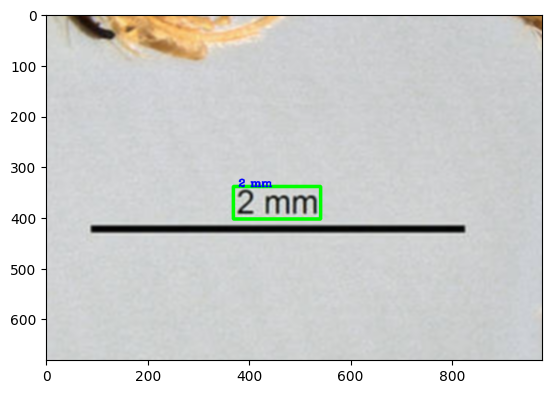

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
2
[ 808 1119    3]
[161 223   0]
 1,0 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


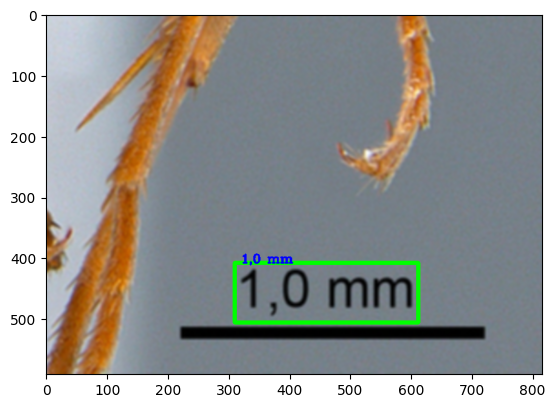

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
3
[ 808 1323    3]
[161 264   0]
 0,5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


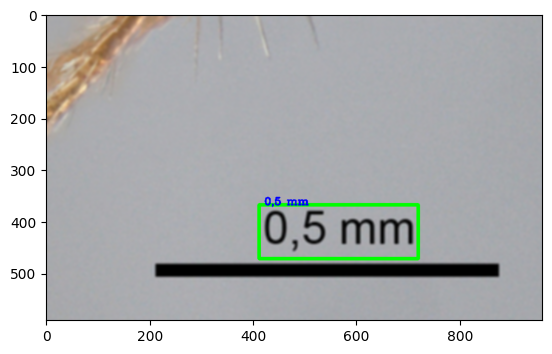

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
4
[ 808 1076    3]
[161 215   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


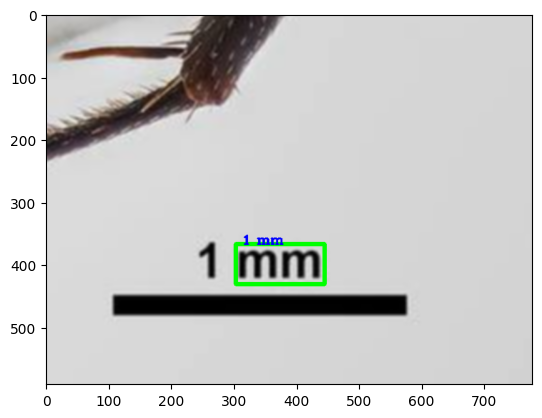

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
5
[ 808 1193    3]
[161 238   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


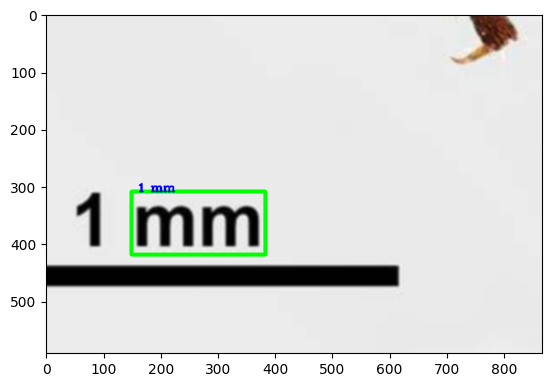

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
6
[ 808 1185    3]
[161 237   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 Imm
<built-in method isnumeric of str object at 0x103e1b8f8>


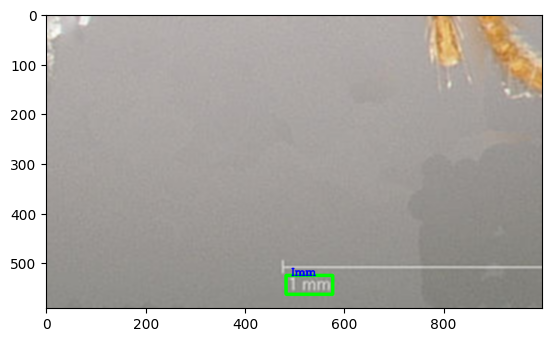

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
7
[ 808 1287    3]
[161 257   0]


Using CPU. Note: This module is much faster with a GPU.


 100 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


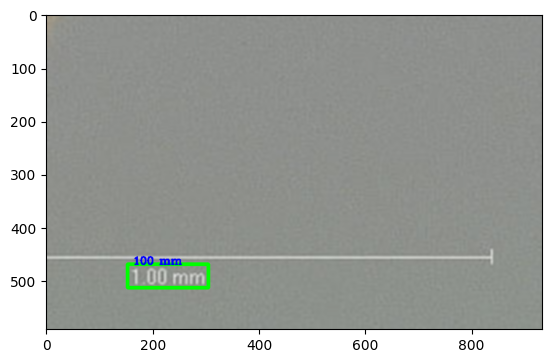

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
8
[ 808 1124    3]
[161 224   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 1.00 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


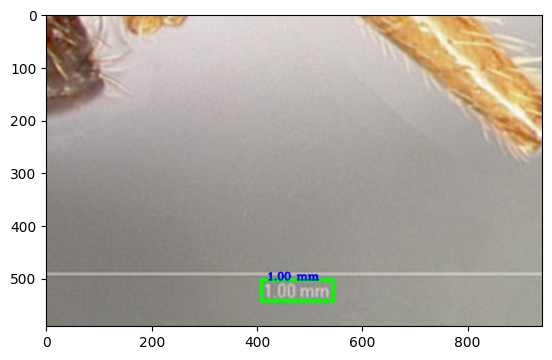

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
9
[ 808 1061    3]
[161 212   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


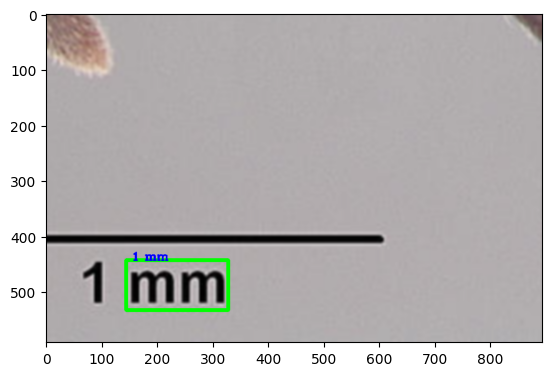

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
10


Using CPU. Note: This module is much faster with a GPU.


[ 808 1122    3]
[161 224   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


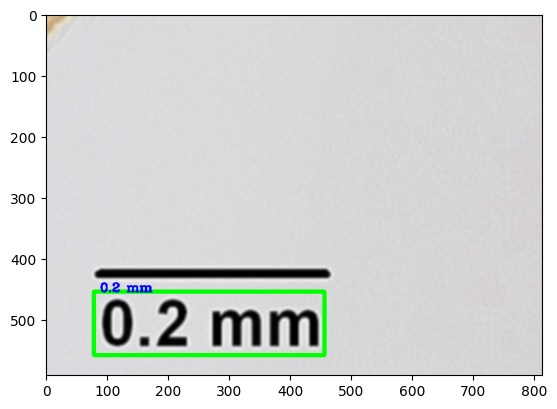

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
11
[ 808 1165    3]
[161 233   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


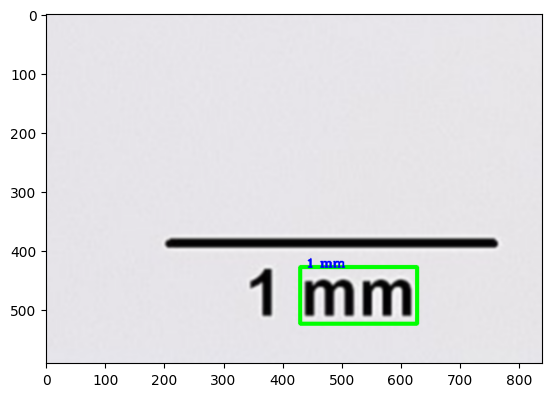

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
12
[808 829   3]
[161 165   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


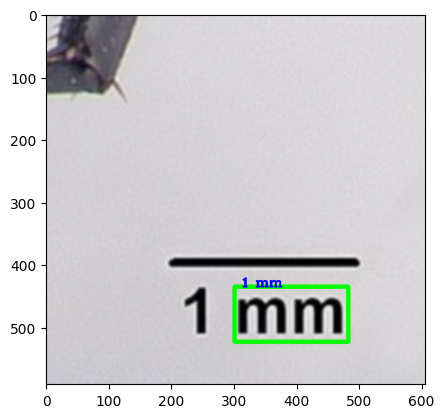

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
13
[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


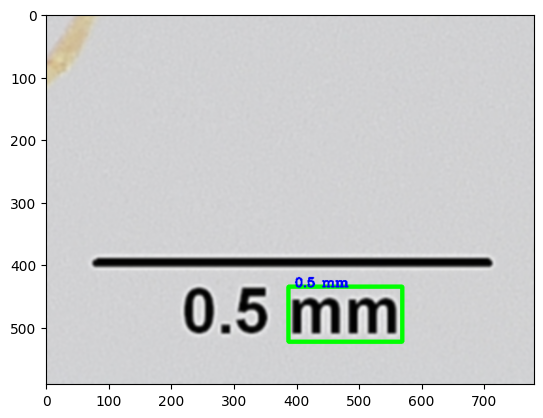

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
14
[ 808 1073    3]
[161 214   0]


Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


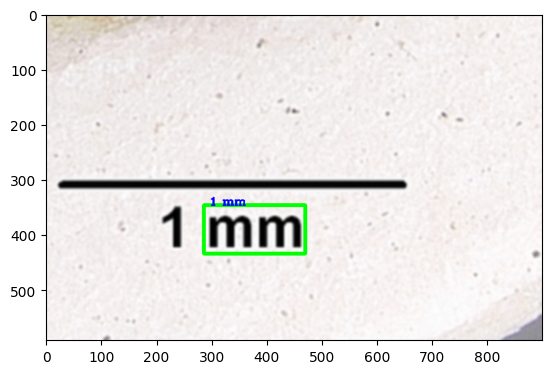

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
15
[ 808 1710    3]
[161 342   0]


Using CPU. Note: This module is much faster with a GPU.


 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


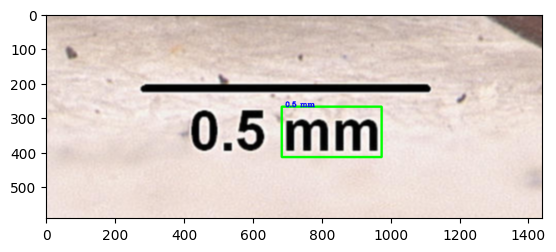

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
16
[ 808 1088    3]
[161 217   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


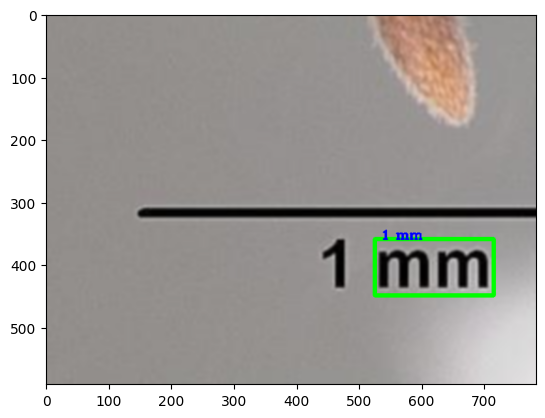

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
17
[ 808 1140    3]
[161 228   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


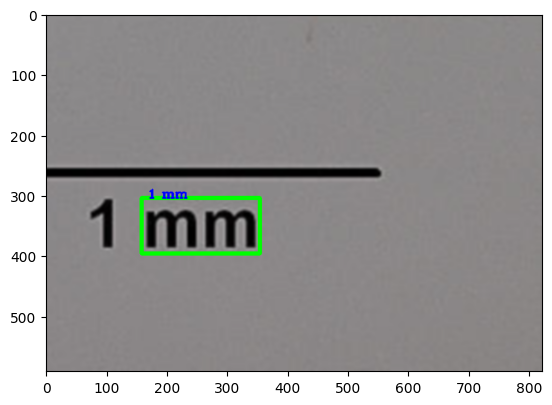

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
18
[ 808 1073    3]
[161 214   0]


Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


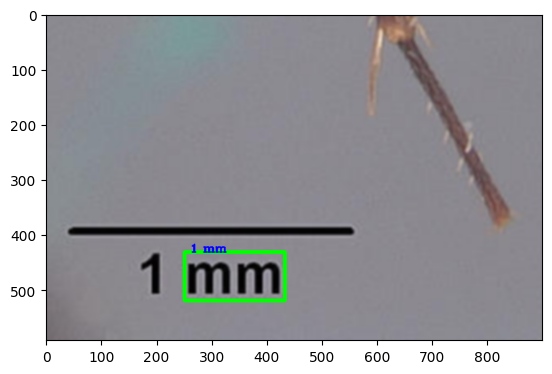

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
19
[ 808 1073    3]
[161 214   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


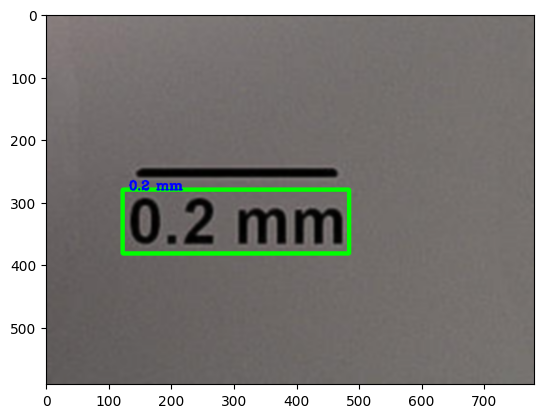

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
20


Using CPU. Note: This module is much faster with a GPU.


[808 997   3]
[161 199   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


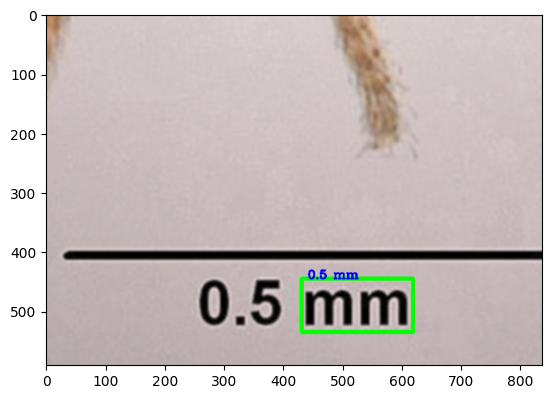

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
21
[ 808 1210    3]
[161 242   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


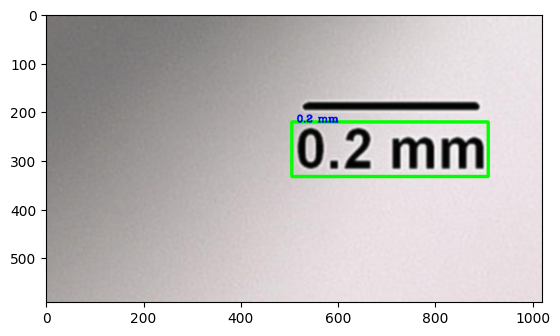

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
22


Using CPU. Note: This module is much faster with a GPU.


[ 808 1117    3]
[161 223   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


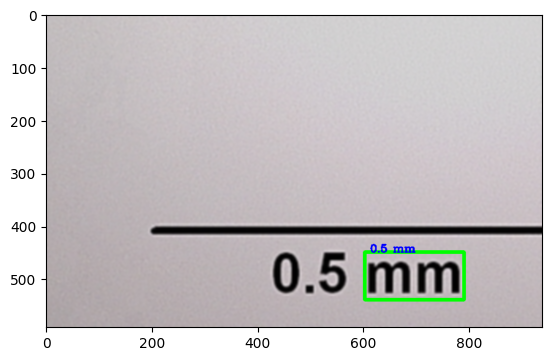

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
23


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


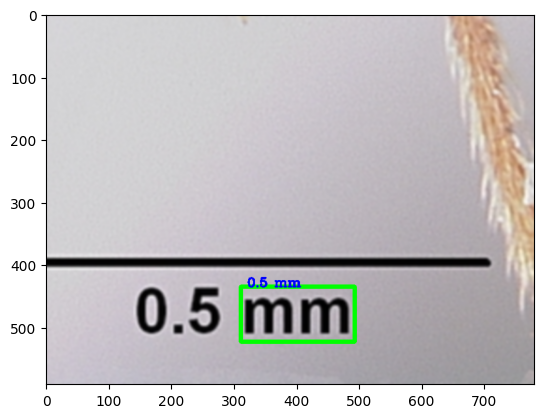

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
24


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


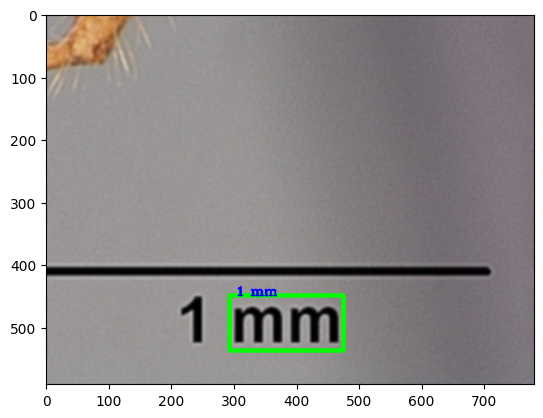

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
25


Using CPU. Note: This module is much faster with a GPU.


[808 995   3]
[161 199   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


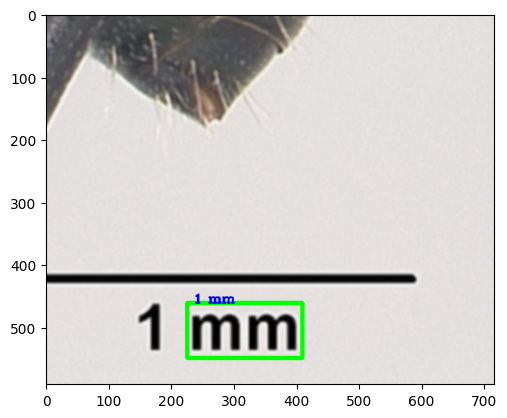

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
26


Using CPU. Note: This module is much faster with a GPU.


[ 808 1149    3]
[161 229   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


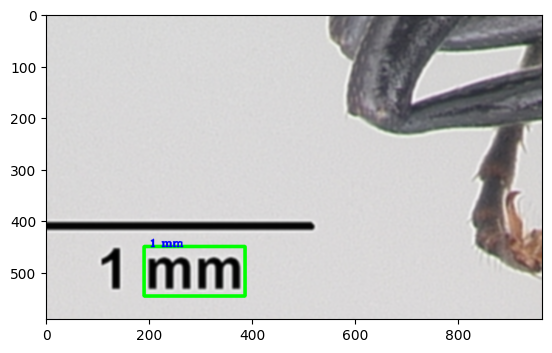

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
27
[ 808 1268    3]
[161 253   0]


Using CPU. Note: This module is much faster with a GPU.


 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


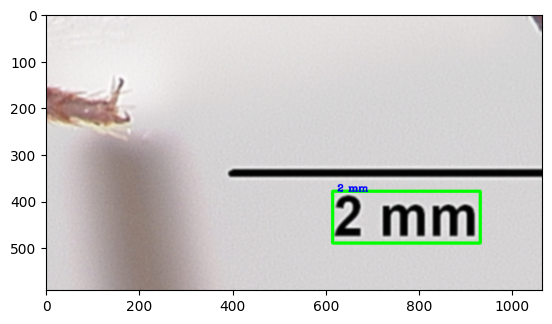

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
28


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


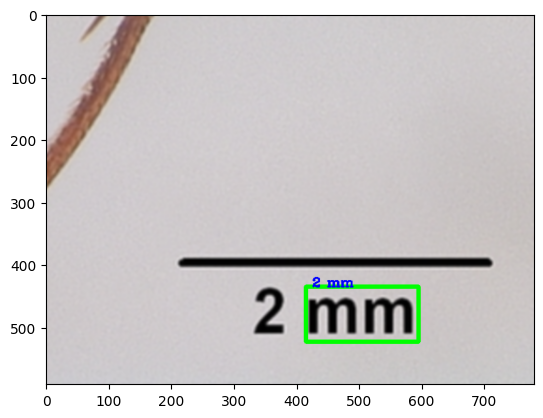

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
29
[ 808 1192    3]
[161 238   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


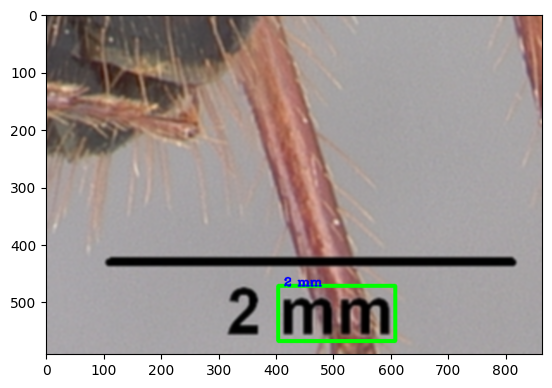

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
30


Using CPU. Note: This module is much faster with a GPU.


[ 808 1450    3]
[161 290   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


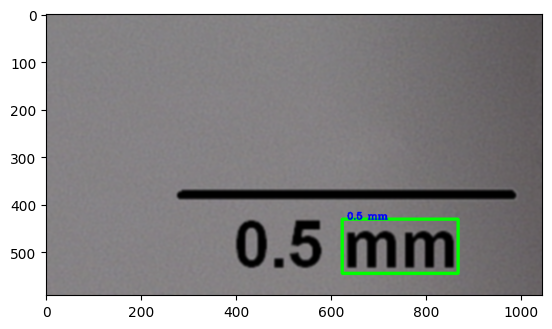

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
31


Using CPU. Note: This module is much faster with a GPU.


[ 808 1313    3]
[161 262   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


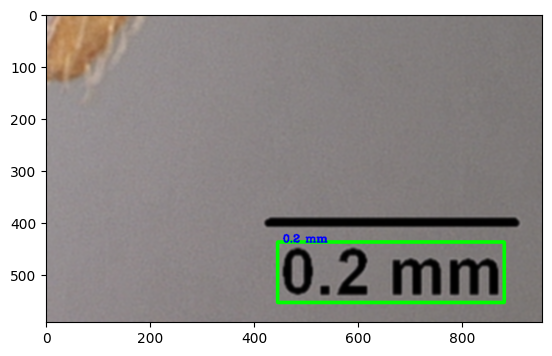

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
32


Using CPU. Note: This module is much faster with a GPU.


[ 808 1113    3]
[161 222   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


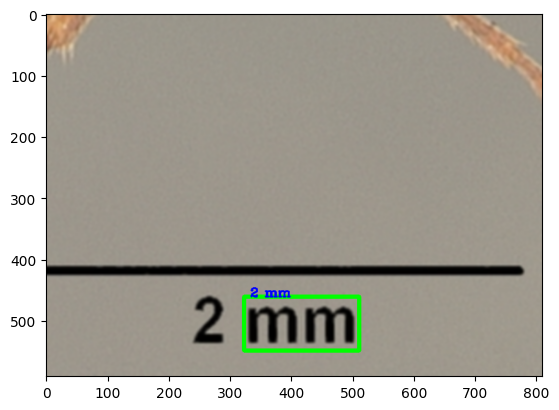

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
33


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


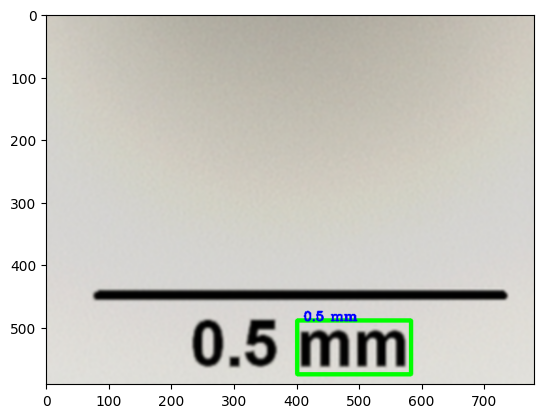

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
34


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


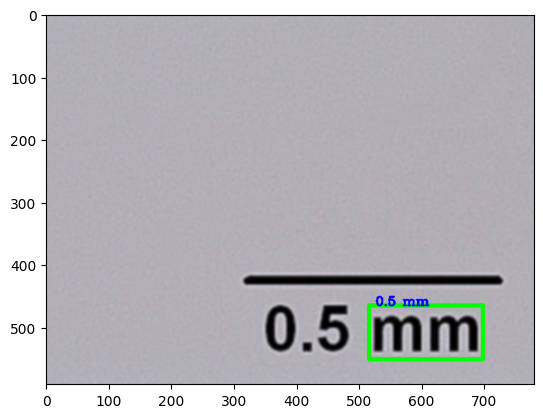

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
35


Using CPU. Note: This module is much faster with a GPU.


[ 808 1287    3]
[161 257   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


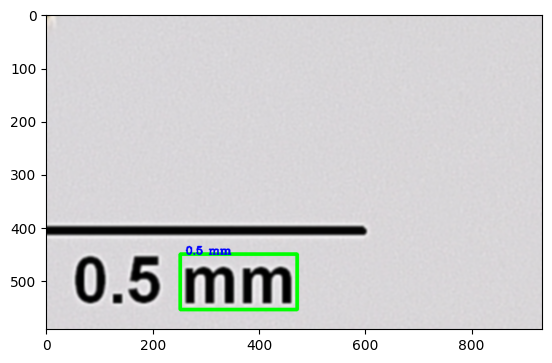

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
36


Using CPU. Note: This module is much faster with a GPU.


[ 808 1072    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


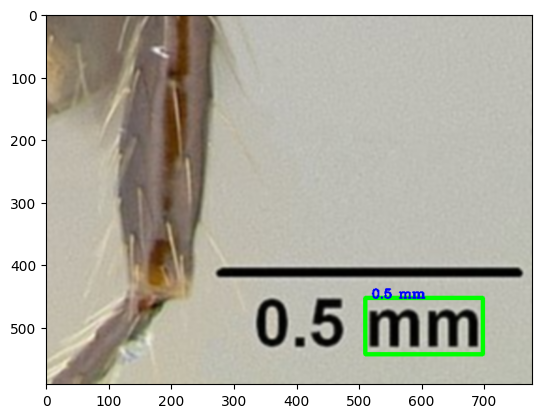

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
37


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


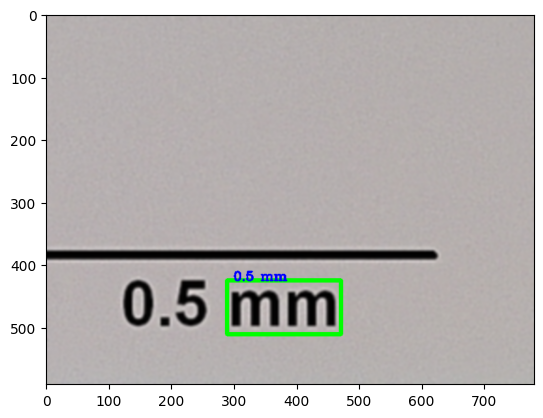

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
38
[ 808 1080    3]
[161 216   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


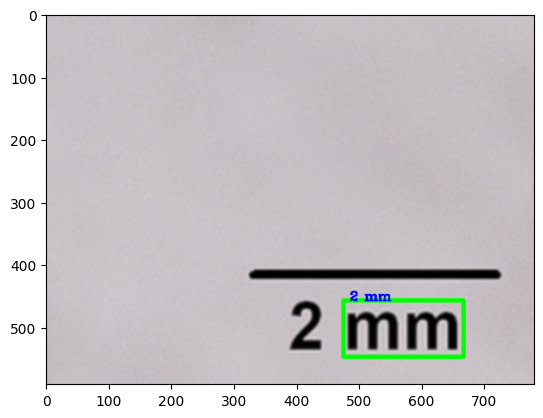

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
39


Using CPU. Note: This module is much faster with a GPU.


[ 808 1156    3]
[161 231   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


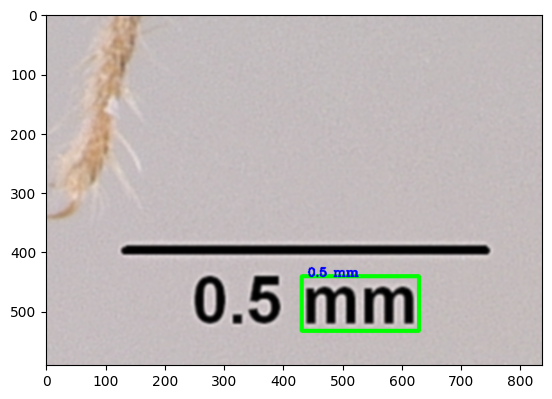

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
40
[ 808 1060    3]
[161 212   0]


Using CPU. Note: This module is much faster with a GPU.


 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


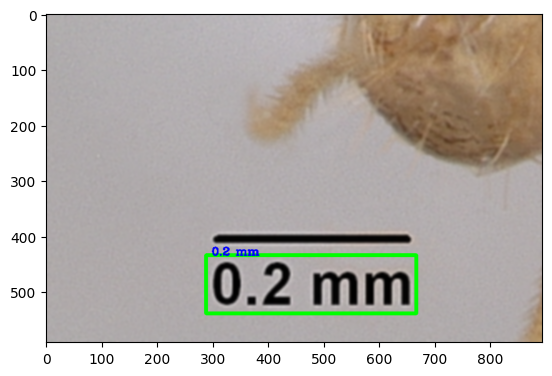

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
41


Using CPU. Note: This module is much faster with a GPU.


[ 808 1078    3]
[161 215   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


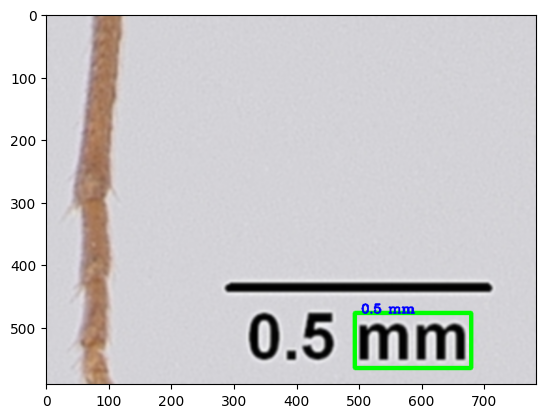

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
42


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


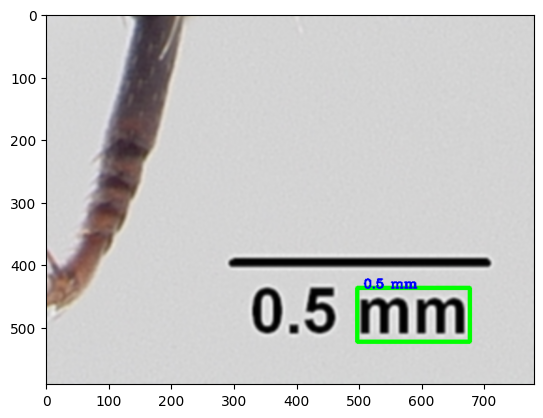

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
43


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


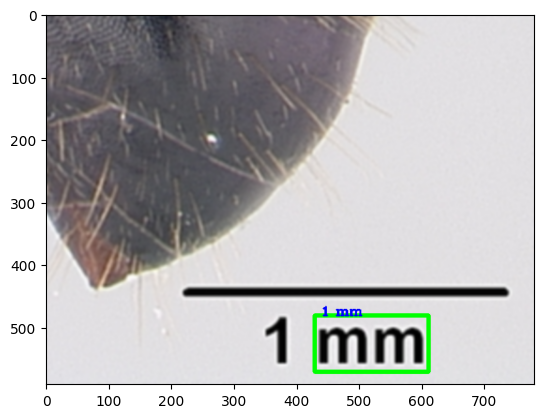

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
44


Using CPU. Note: This module is much faster with a GPU.


[808 927   3]
[161 185   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


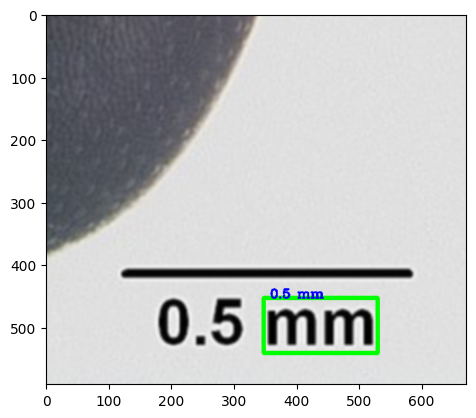

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
45


Using CPU. Note: This module is much faster with a GPU.


[ 808 1193    3]
[161 238   0]
 0.1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


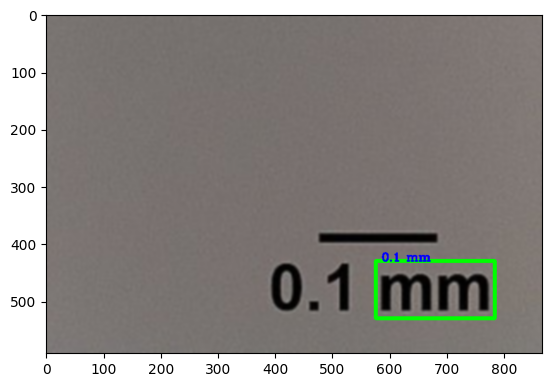

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
46


Using CPU. Note: This module is much faster with a GPU.


[ 808 1136    3]
[161 227   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


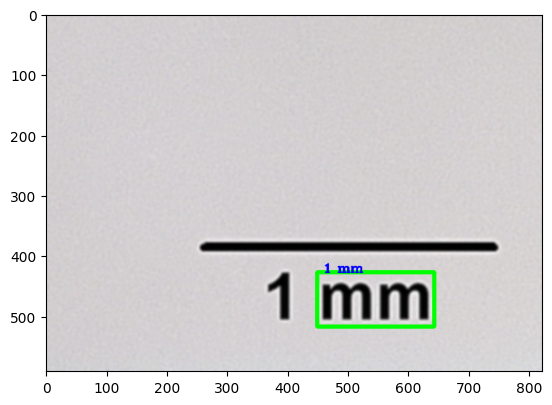

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
47


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


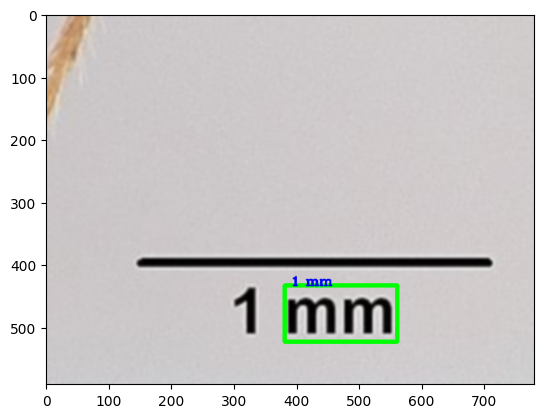

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
48


Using CPU. Note: This module is much faster with a GPU.


[808 965   3]
[161 193   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


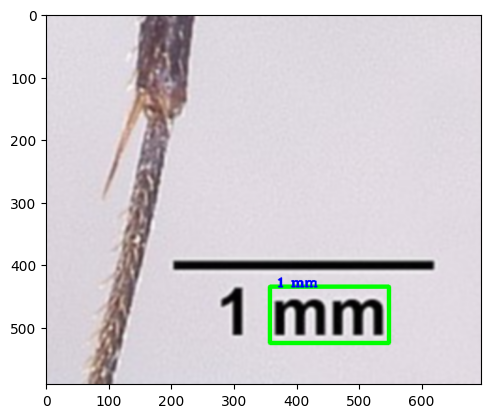

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
49


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 1.0 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


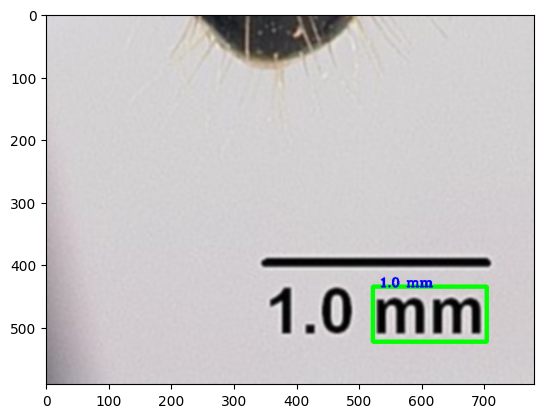

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
50


Using CPU. Note: This module is much faster with a GPU.


[808 894   3]
[161 178   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


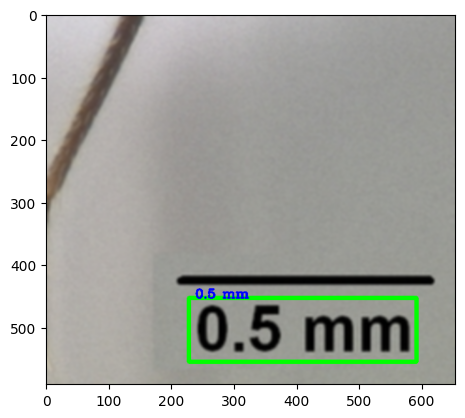

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
51


Using CPU. Note: This module is much faster with a GPU.


[808 906   3]
[161 181   0]
 0.6 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


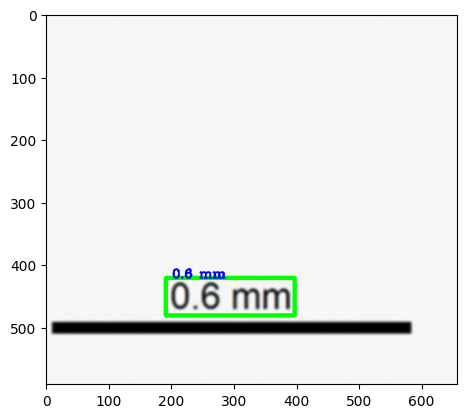

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
52


Using CPU. Note: This module is much faster with a GPU.


[ 808 1000    3]
[161 200   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


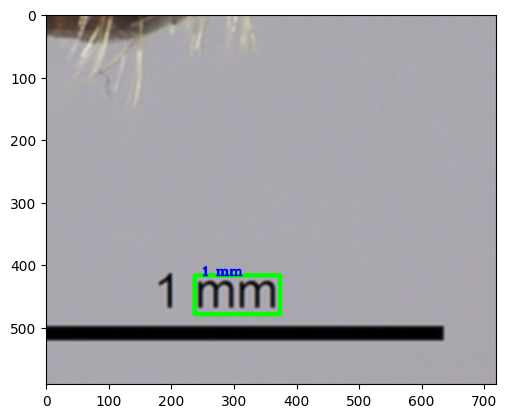

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
53
[ 808 1175    3]
[161 235   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


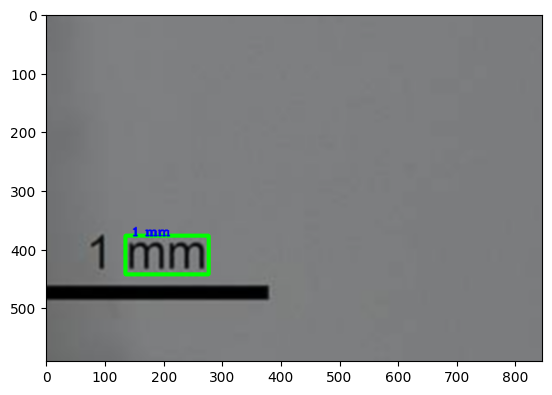

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
54


Using CPU. Note: This module is much faster with a GPU.


[808 884   3]
[161 176   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


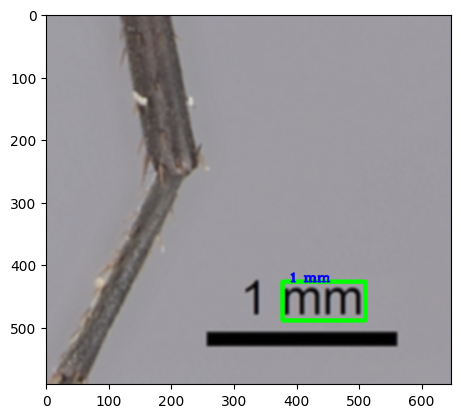

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
55


Using CPU. Note: This module is much faster with a GPU.


[808 929   3]
[161 185   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


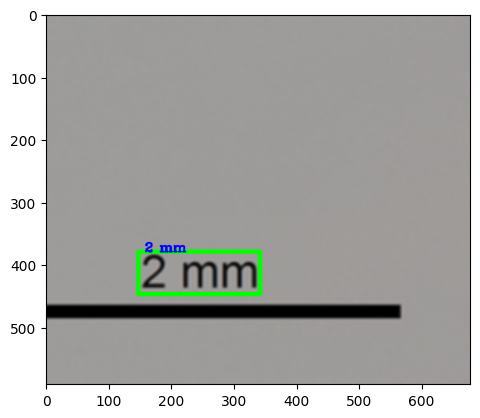

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
56


Using CPU. Note: This module is much faster with a GPU.


[808 895   3]
[161 179   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


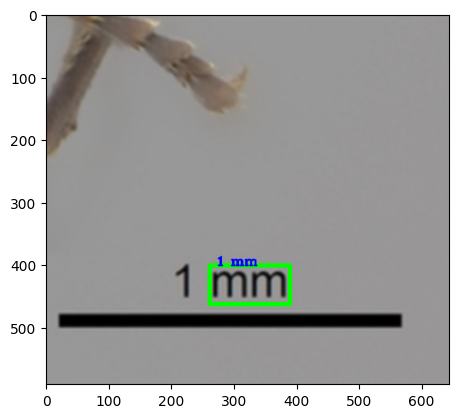

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
57
[808 936   3]
[161 187   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


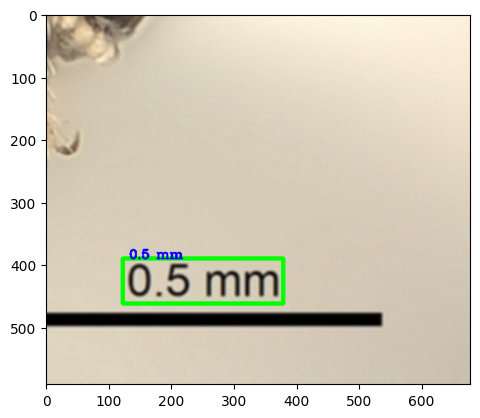

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
58
[ 808 1047    3]
[161 209   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


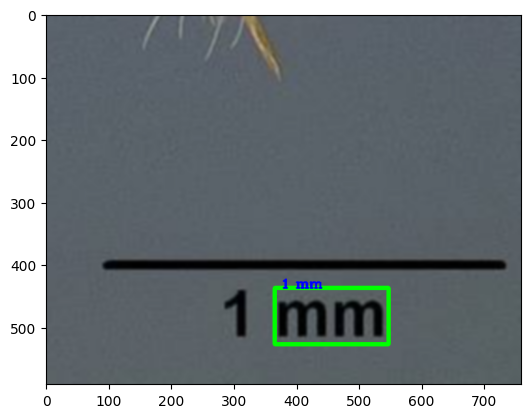

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
59


Using CPU. Note: This module is much faster with a GPU.


[ 808 1015    3]
[161 203   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


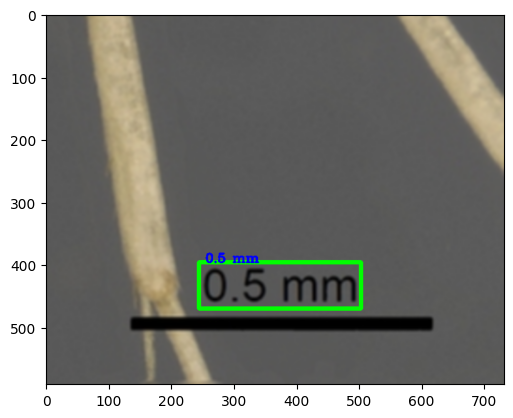

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
60


Using CPU. Note: This module is much faster with a GPU.


[808 980   3]
[161 196   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


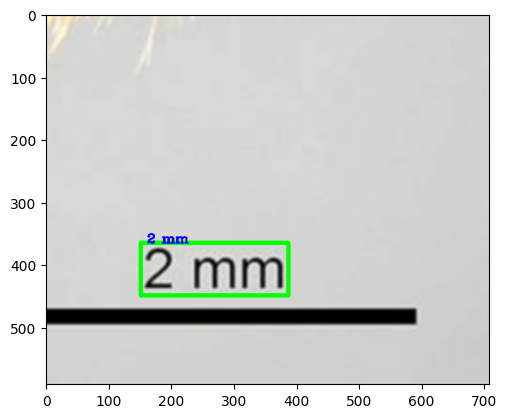

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
61


Using CPU. Note: This module is much faster with a GPU.


[ 808 1012    3]
[161 202   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


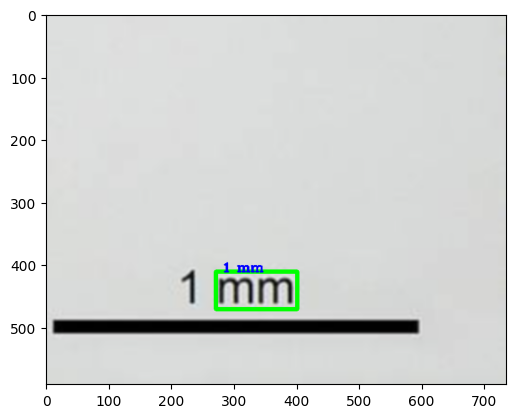

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
62


Using CPU. Note: This module is much faster with a GPU.


[ 808 1246    3]
[161 249   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


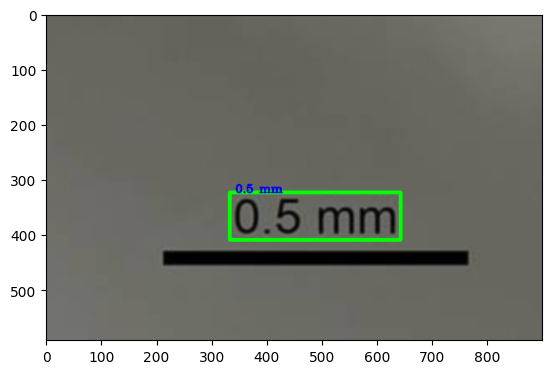

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
63


Using CPU. Note: This module is much faster with a GPU.


[ 808 1254    3]
[161 250   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


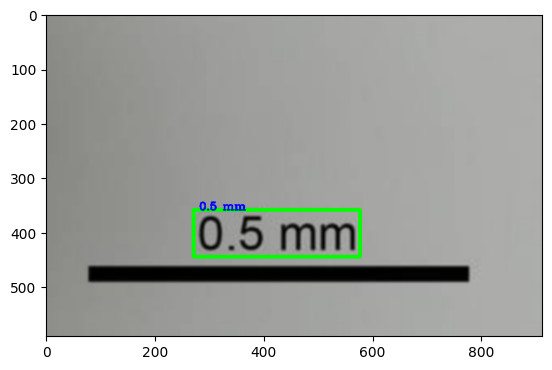

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
64


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


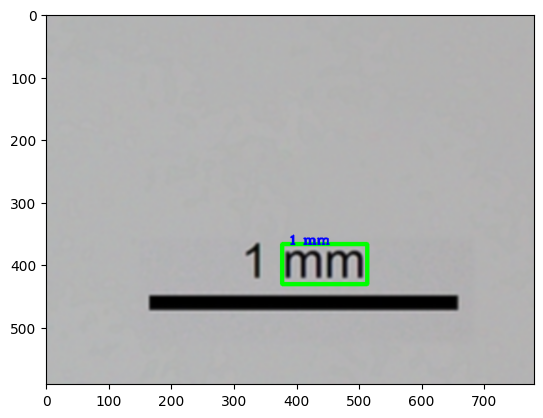

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
65


Using CPU. Note: This module is much faster with a GPU.


[ 808 1055    3]
[161 211   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


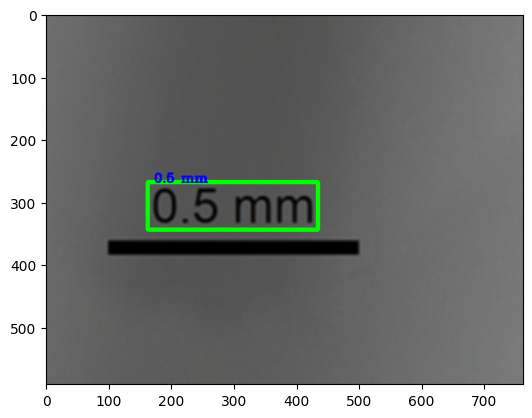

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
66


Using CPU. Note: This module is much faster with a GPU.


[808 889   3]
[161 177   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


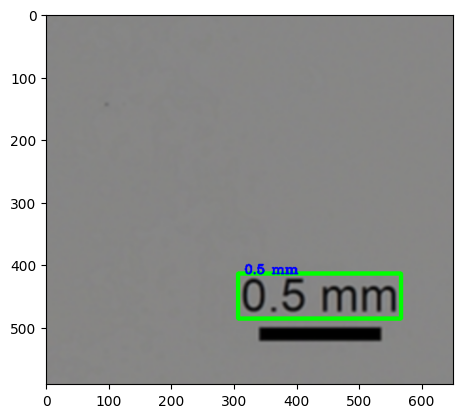

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
67


Using CPU. Note: This module is much faster with a GPU.


[ 808 1252    3]
[161 250   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


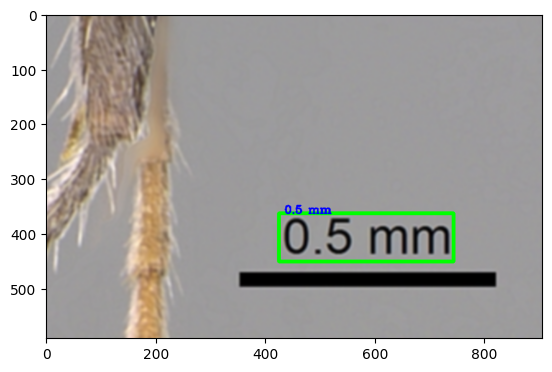

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
68


Using CPU. Note: This module is much faster with a GPU.


[ 808 1085    3]
[161 217   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


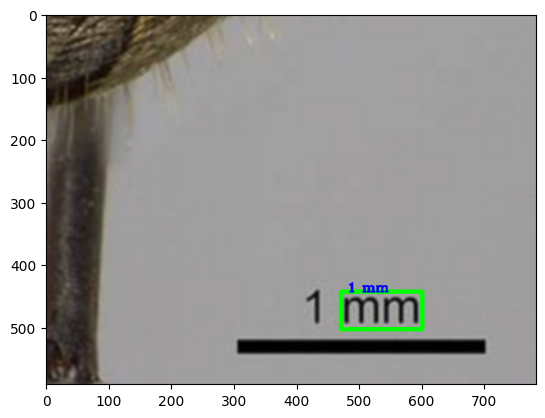

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
69


Using CPU. Note: This module is much faster with a GPU.


[ 808 1036    3]
[161 207   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


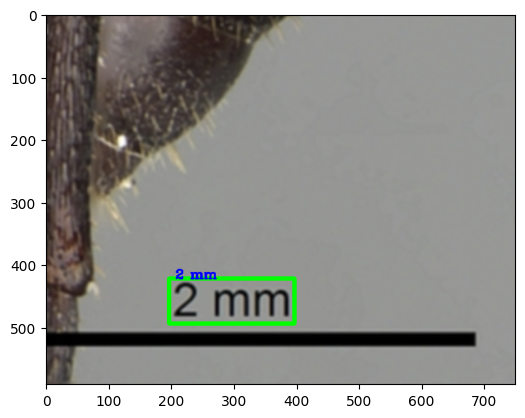

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
70
[ 808 1122    3]
[161 224   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


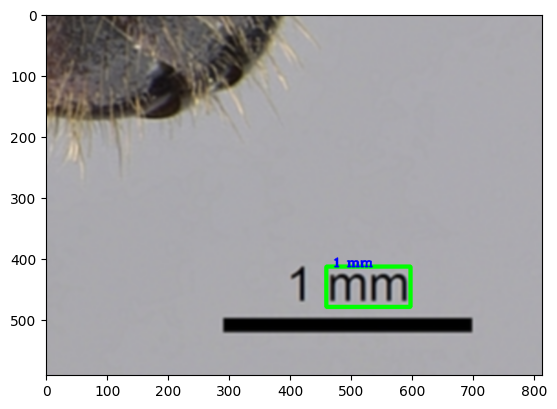

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
71
[808 823   3]
[161 164   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


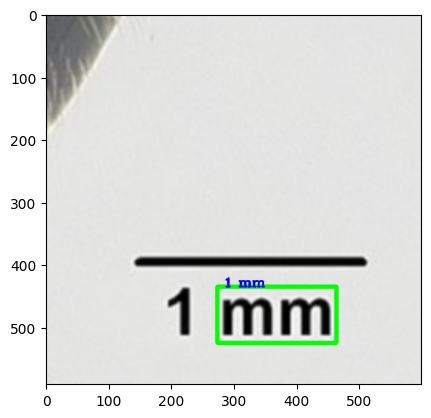

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
72


Using CPU. Note: This module is much faster with a GPU.


[ 808 1046    3]
[161 209   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


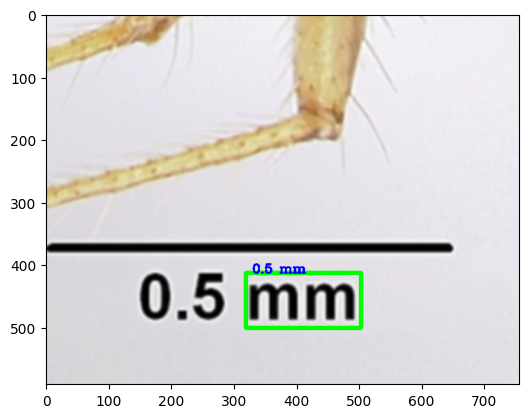

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
73


Using CPU. Note: This module is much faster with a GPU.


[808 968   3]
[161 193   0]


Using CPU. Note: This module is much faster with a GPU.


 LOmm
<built-in method isnumeric of str object at 0x103e1b8f8>


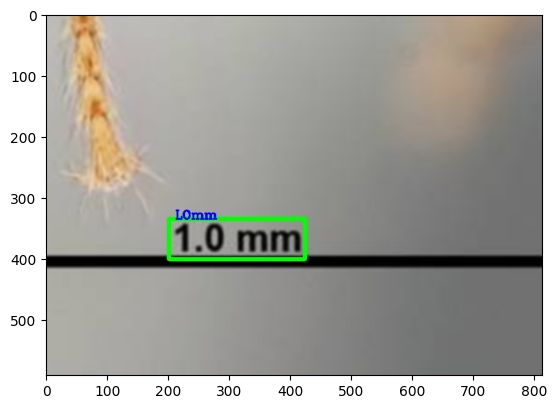

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
74


Using CPU. Note: This module is much faster with a GPU.


[808 927   3]
[161 185   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


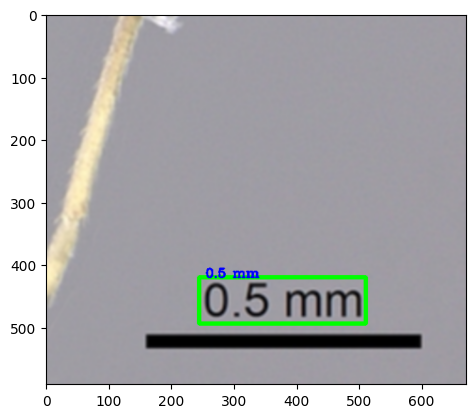

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
75


Using CPU. Note: This module is much faster with a GPU.


[ 808 1082    3]
[161 216   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


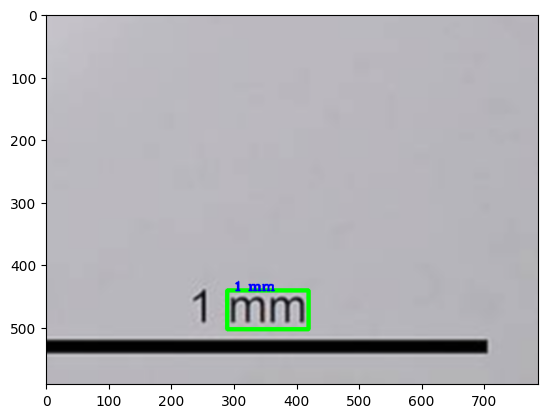

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
76


Using CPU. Note: This module is much faster with a GPU.


[ 808 1123    3]
[161 224   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


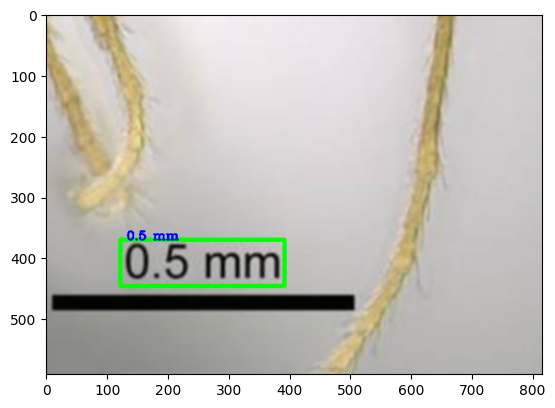

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
77


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


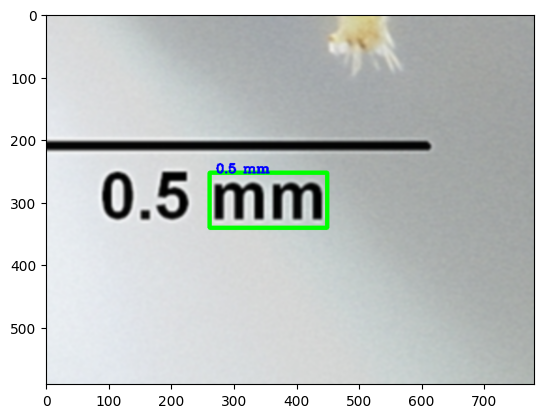

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
78


Using CPU. Note: This module is much faster with a GPU.


[ 808 1037    3]
[161 207   0]


Using CPU. Note: This module is much faster with a GPU.


 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


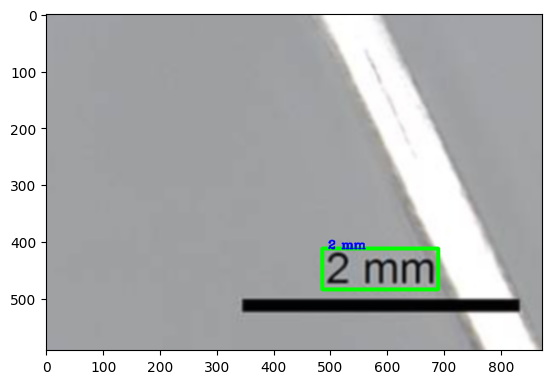

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
79


Using CPU. Note: This module is much faster with a GPU.


[ 808 1169    3]
[161 233   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


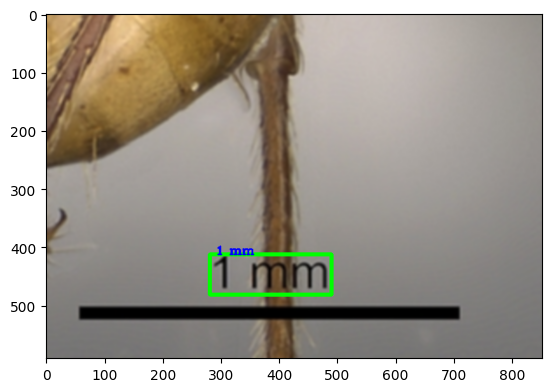

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
80


Using CPU. Note: This module is much faster with a GPU.


[ 808 1099    3]
[161 219   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


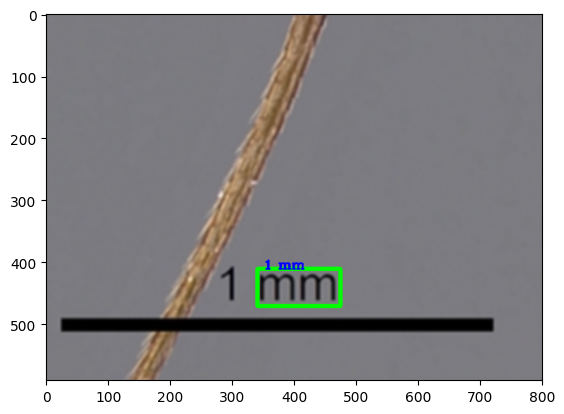

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
81


Using CPU. Note: This module is much faster with a GPU.


[ 808 1312    3]
[161 262   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


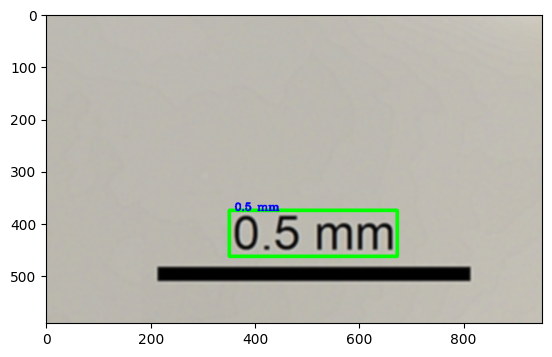

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
82


Using CPU. Note: This module is much faster with a GPU.


[ 808 1305    3]
[161 261   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


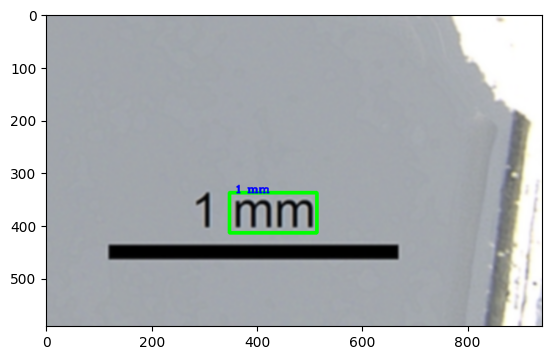

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
83


Using CPU. Note: This module is much faster with a GPU.


[ 808 1002    3]
[161 200   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


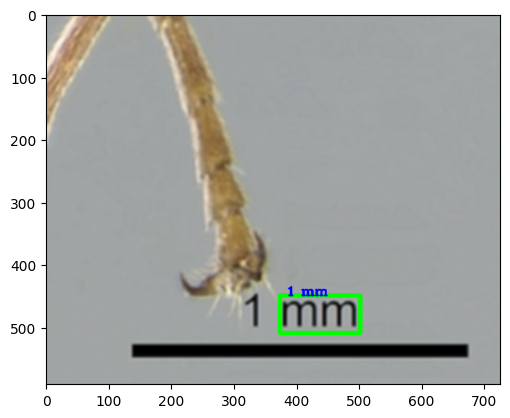

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
84


Using CPU. Note: This module is much faster with a GPU.


[ 808 1083    3]
[161 216   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


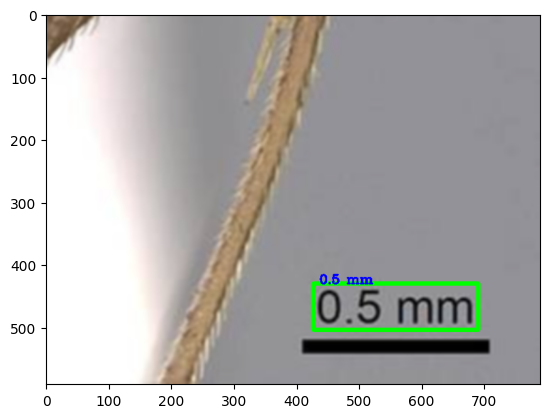

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
85


Using CPU. Note: This module is much faster with a GPU.


[ 808 1083    3]
[161 216   0]


Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


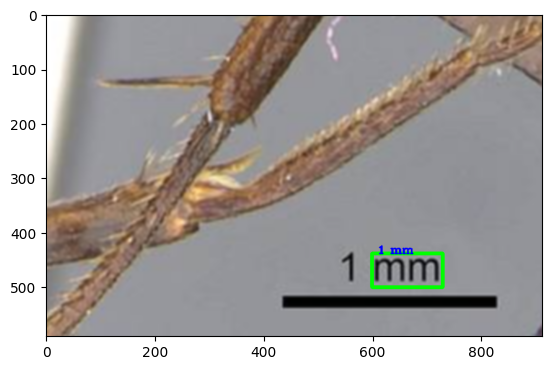

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
86


Using CPU. Note: This module is much faster with a GPU.


[ 808 1205    3]
[161 241   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


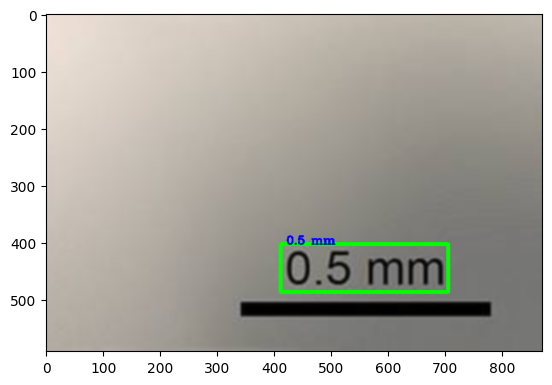

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
87


Using CPU. Note: This module is much faster with a GPU.


[ 808 1076    3]
[161 215   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


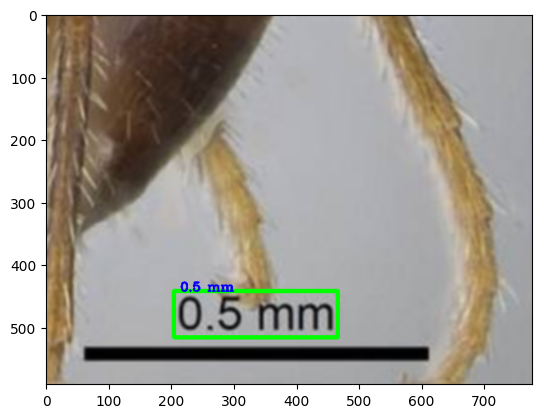

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
88


Using CPU. Note: This module is much faster with a GPU.


[ 808 1309    3]
[161 261   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 1mm
<built-in method isnumeric of str object at 0x103e1b8f8>


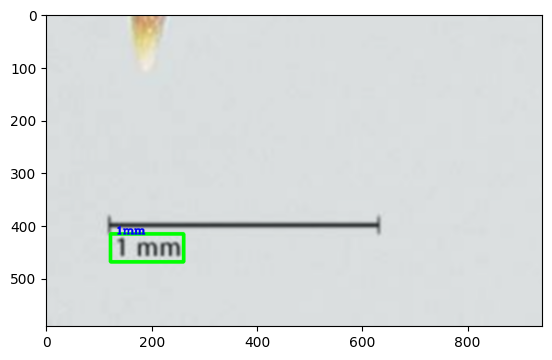

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
89


Using CPU. Note: This module is much faster with a GPU.


[ 808 1369    3]
[161 273   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


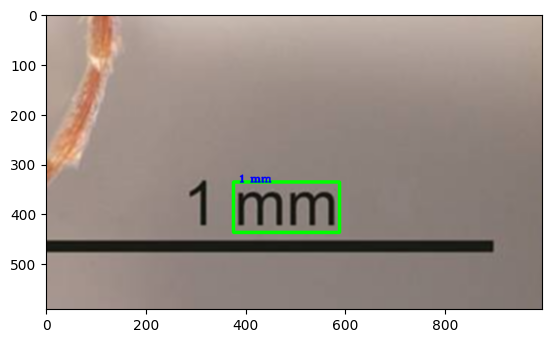

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
90


Using CPU. Note: This module is much faster with a GPU.


[ 808 1392    3]
[161 278   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


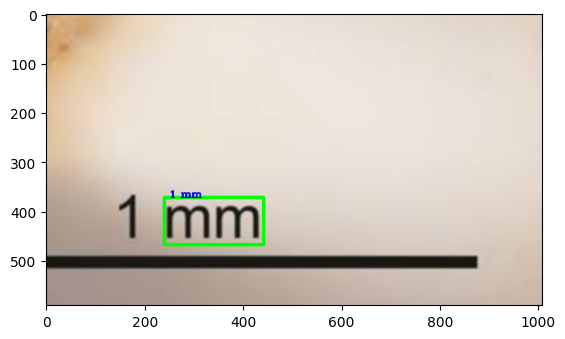

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
91


Using CPU. Note: This module is much faster with a GPU.


[ 808 1467    3]
[161 293   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


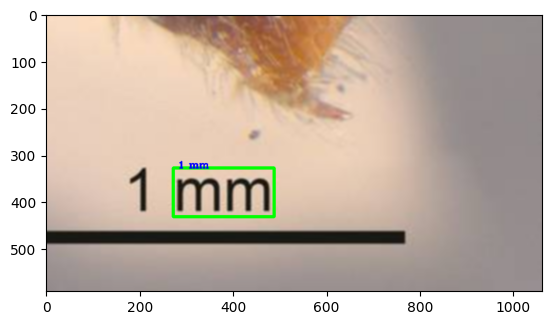

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
92


Using CPU. Note: This module is much faster with a GPU.


[ 808 1050    3]
[161 210   0]
 nm 4
<built-in method isnumeric of str object at 0x103e1b8f8>


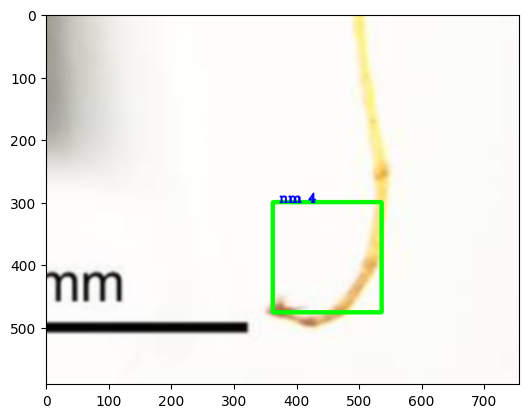

Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


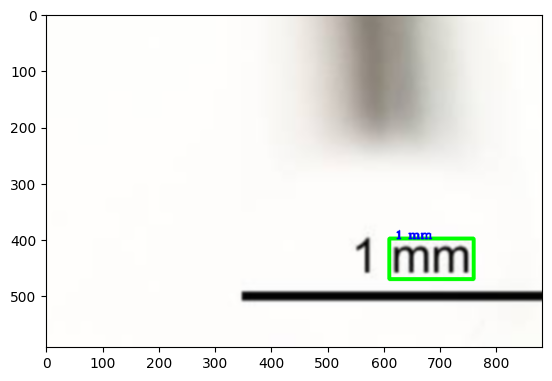

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
93


Using CPU. Note: This module is much faster with a GPU.


[ 808 1132    3]
[161 226   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


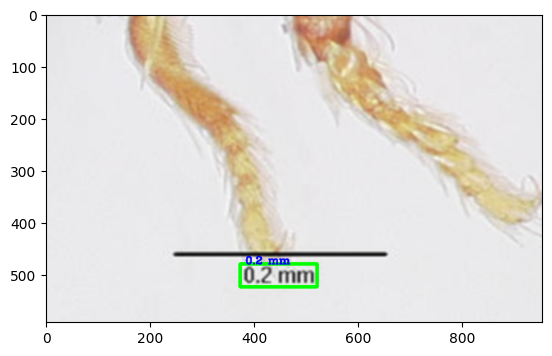

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
94


Using CPU. Note: This module is much faster with a GPU.


[ 808 1120    3]
[161 224   0]


Using CPU. Note: This module is much faster with a GPU.


 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


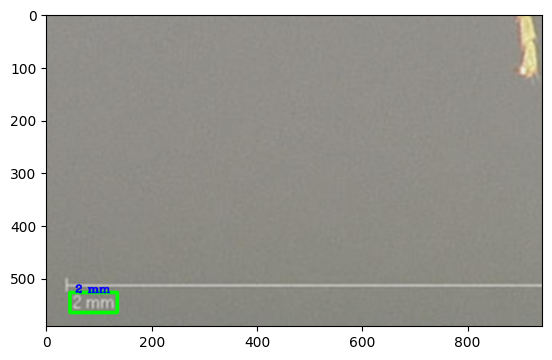

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
95
[ 808 1200    3]
[161 240   0]


Using CPU. Note: This module is much faster with a GPU.


 1 Mm
<built-in method isnumeric of str object at 0x103e1b8f8>


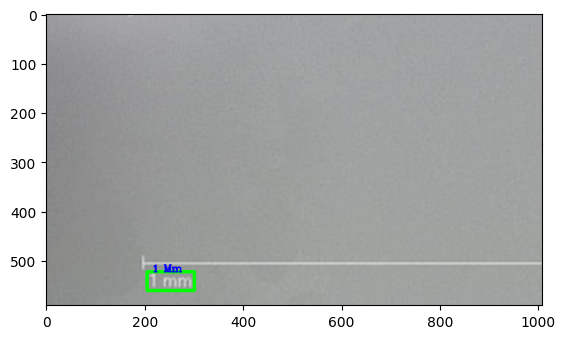

Using CPU. Note: This module is much faster with a GPU.


 11 mn
<built-in method isnumeric of str object at 0x103e1b8f8>


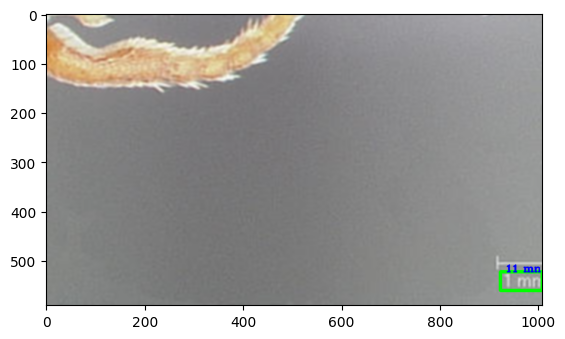

Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
96


Using CPU. Note: This module is much faster with a GPU.


[ 808 1153    3]
[161 230   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 0.50 Im
<built-in method isnumeric of str object at 0x103e1b8f8>


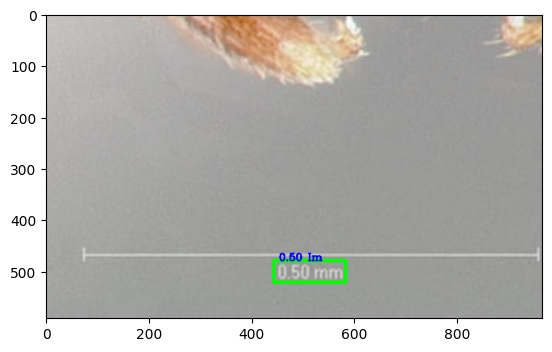

Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
97


Using CPU. Note: This module is much faster with a GPU.


[ 808 1152    3]
[161 230   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


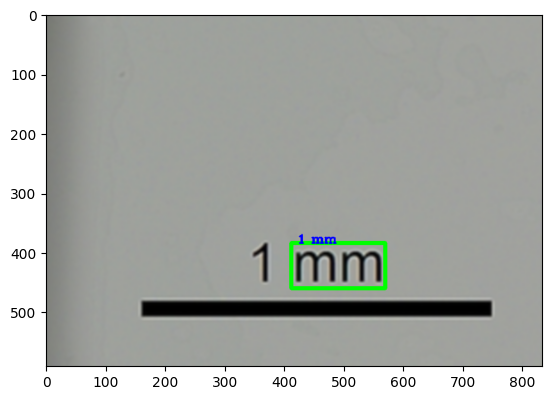

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
98


Using CPU. Note: This module is much faster with a GPU.


[ 808 1206    3]
[161 241   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


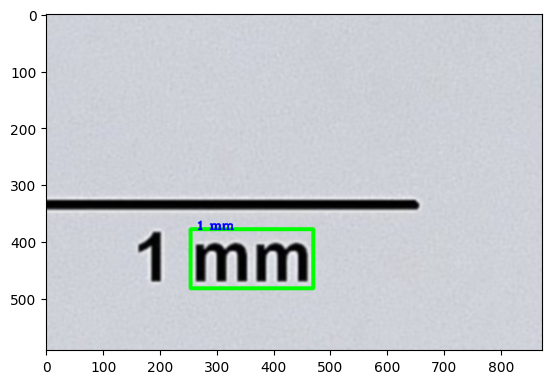

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
99


Using CPU. Note: This module is much faster with a GPU.


[ 808 1093    3]
[161 218   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


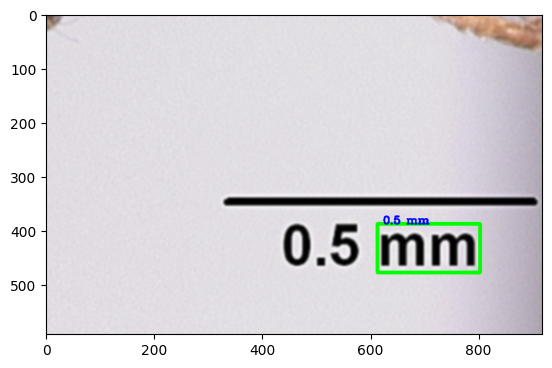

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
100


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


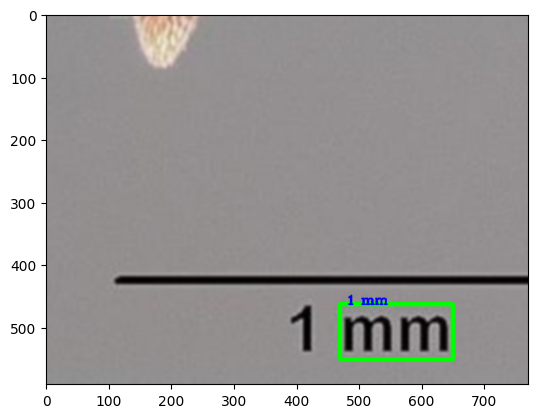

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
101


Using CPU. Note: This module is much faster with a GPU.


[ 808 1014    3]
[161 202   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


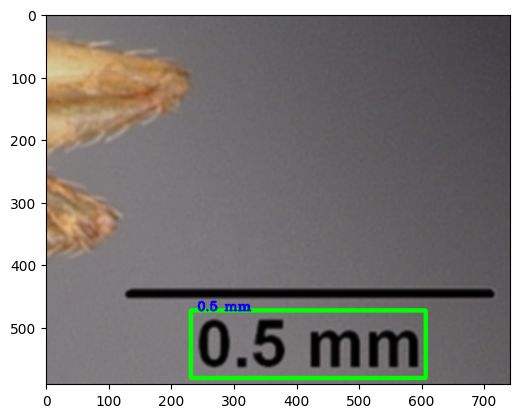

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
102


Using CPU. Note: This module is much faster with a GPU.


[1148 1600    3]
[229 320   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 1.00 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


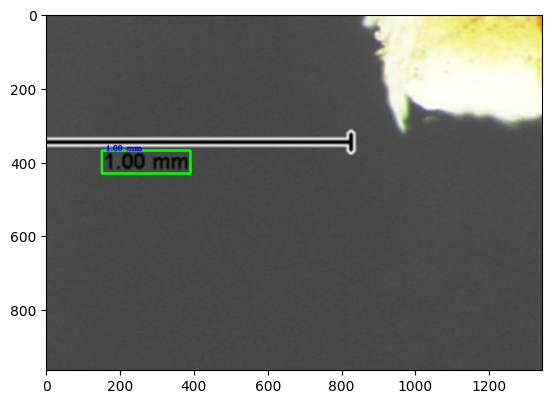

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
103


Using CPU. Note: This module is much faster with a GPU.


[ 808 1242    3]
[161 248   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


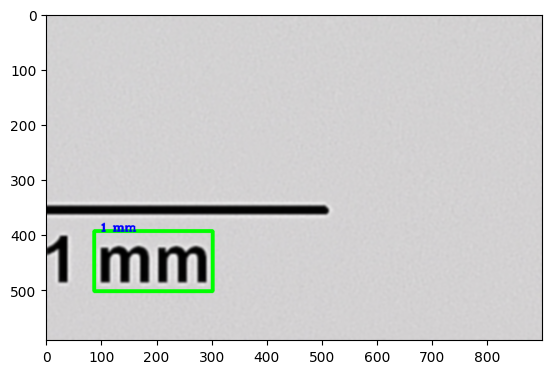

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
104
[ 808 1073    3]
[161 214   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


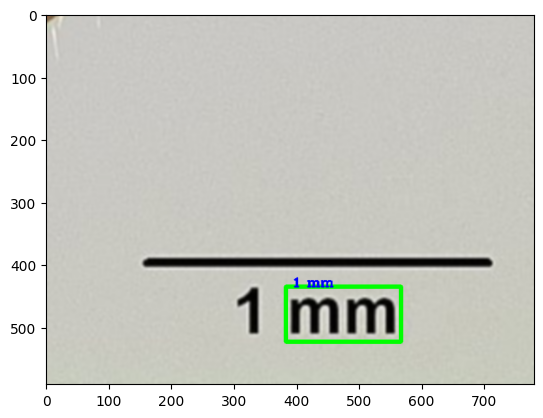

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
105
[ 808 1073    3]
[161 214   0]
 1.0 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


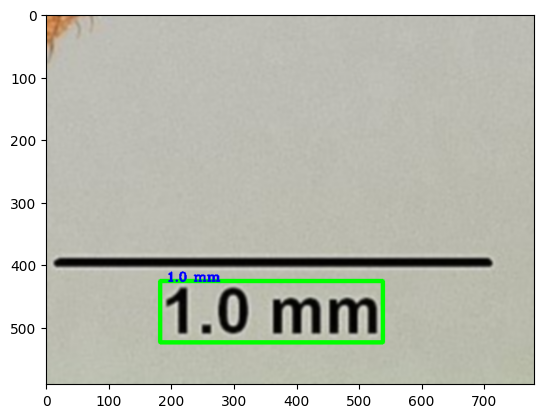

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
106


Using CPU. Note: This module is much faster with a GPU.


[ 808 1166    3]
[161 233   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


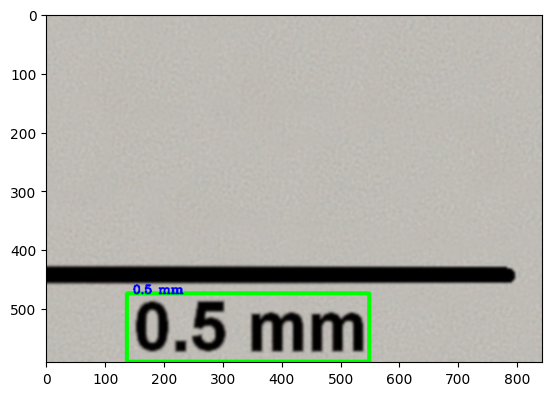

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
107


Using CPU. Note: This module is much faster with a GPU.


[ 808 1055    3]
[161 211   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


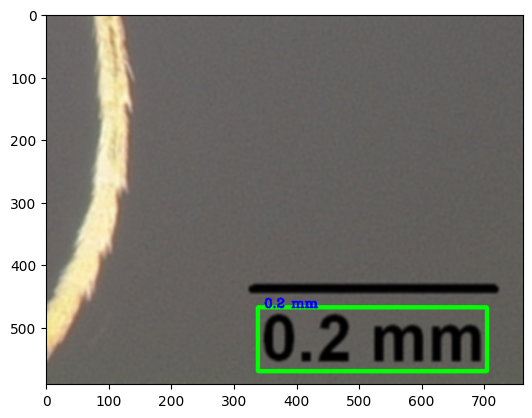

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
108


Using CPU. Note: This module is much faster with a GPU.


[ 808 1083    3]
[161 216   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


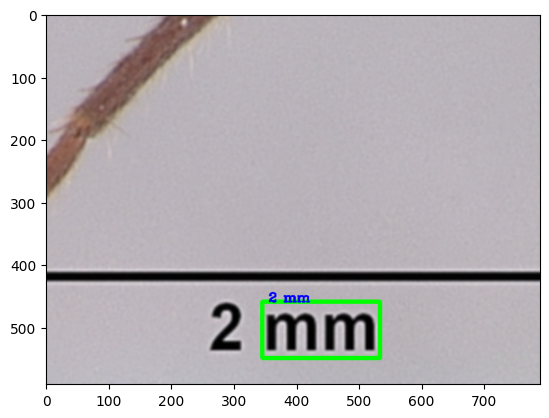

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
109


Using CPU. Note: This module is much faster with a GPU.


[ 808 1040    3]
[161 208   0]


Using CPU. Note: This module is much faster with a GPU.


 Al 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


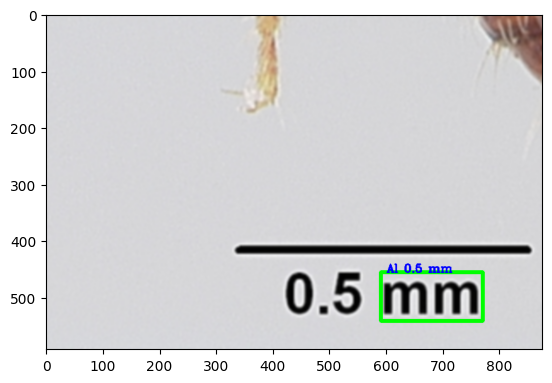

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
110


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


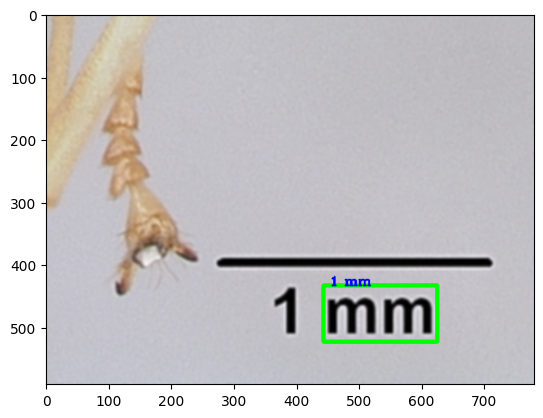

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
111


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


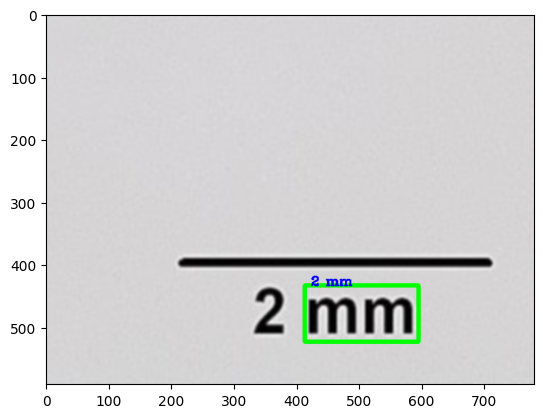

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
112


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


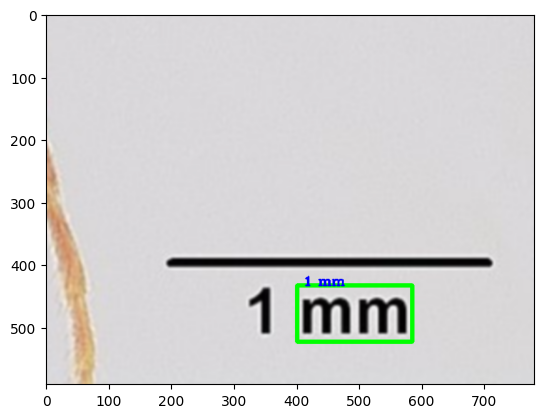

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
113
[808 983   3]
[161 196   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


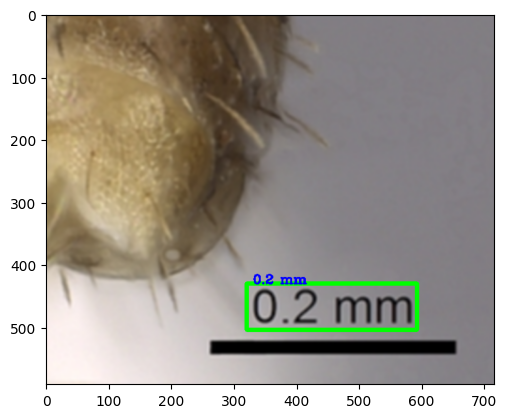

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
114


Using CPU. Note: This module is much faster with a GPU.


[ 808 1080    3]
[161 216   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


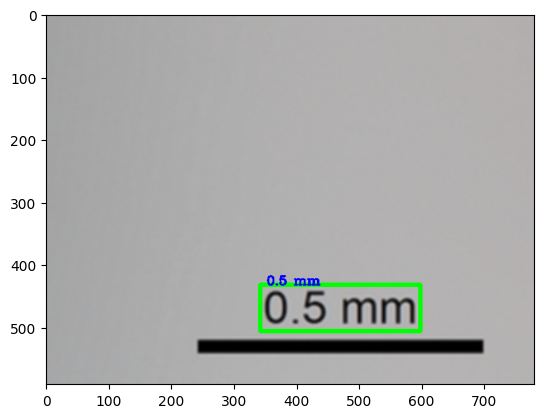

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
115


Using CPU. Note: This module is much faster with a GPU.


[ 808 1262    3]
[161 252   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


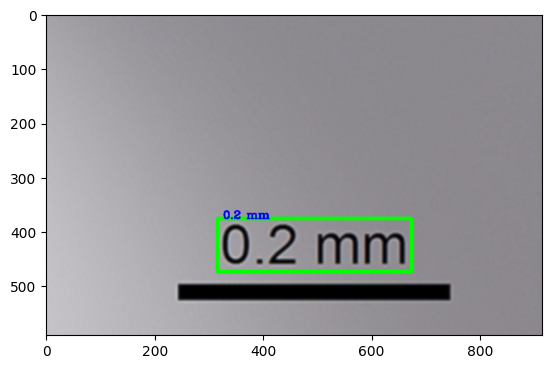

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
116


Using CPU. Note: This module is much faster with a GPU.


[808 984   3]
[161 196   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


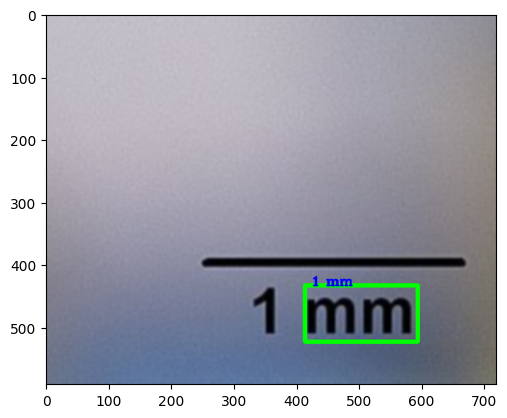

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
117


Using CPU. Note: This module is much faster with a GPU.


[ 808 1172    3]
[161 234   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


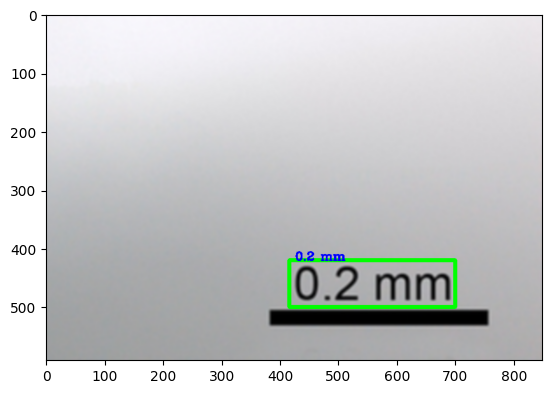

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
118


Using CPU. Note: This module is much faster with a GPU.


[ 808 1064    3]
[161 212   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


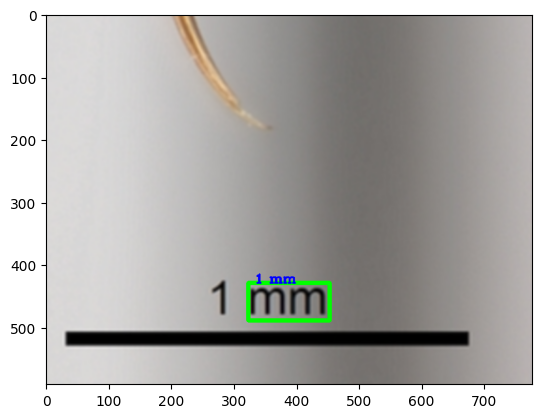

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
119


Using CPU. Note: This module is much faster with a GPU.


[808 970   3]
[161 194   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


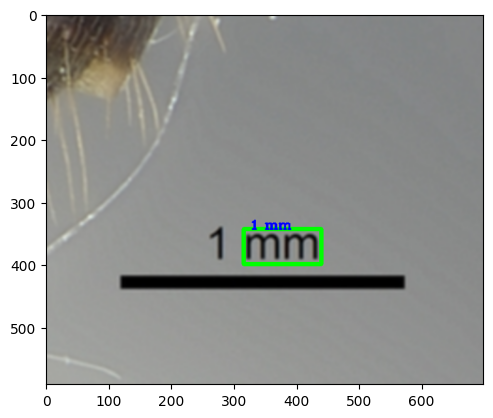

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
120


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


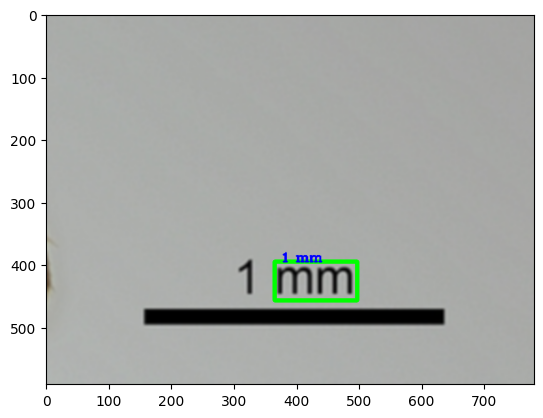

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
121


Using CPU. Note: This module is much faster with a GPU.


[ 808 1803    3]
[161 360   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


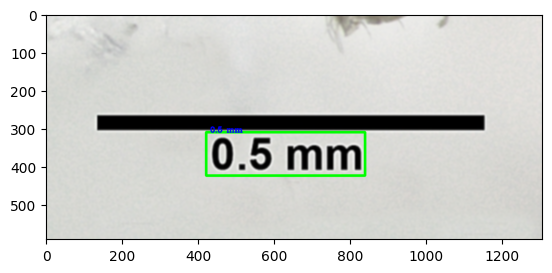

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
122


Using CPU. Note: This module is much faster with a GPU.


[ 808 1127    3]
[161 225   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


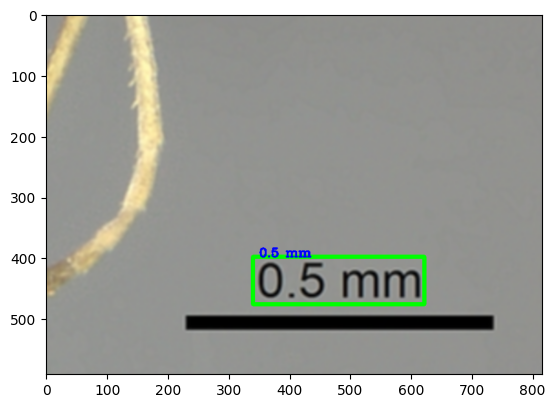

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
123


Using CPU. Note: This module is much faster with a GPU.


[ 808 1086    3]
[161 217   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


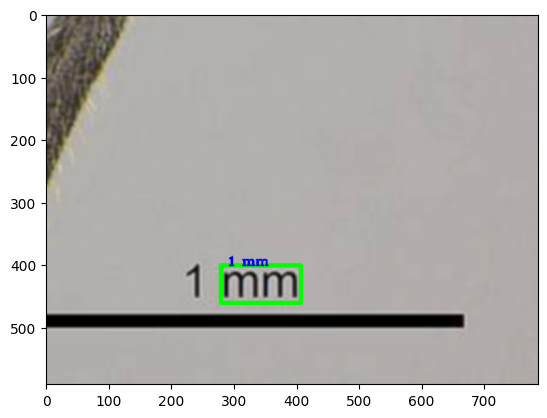

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
124
[1123 1600    3]
[224 320   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


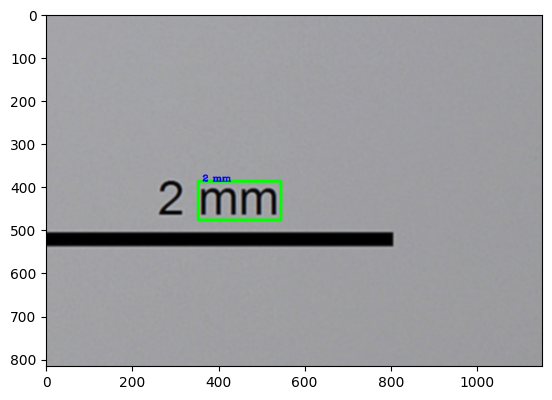

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
125
[ 808 1077    3]
[161 215   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


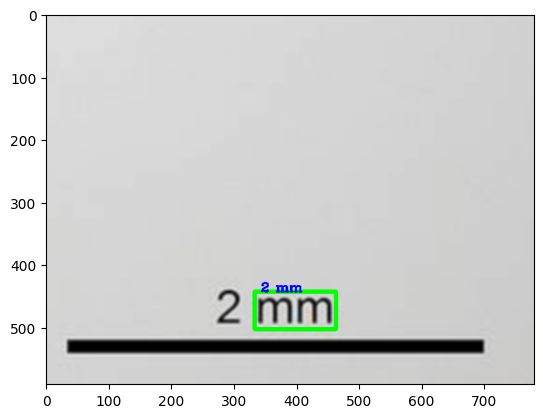

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
126


Using CPU. Note: This module is much faster with a GPU.


[1192 1600    3]
[238 320   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


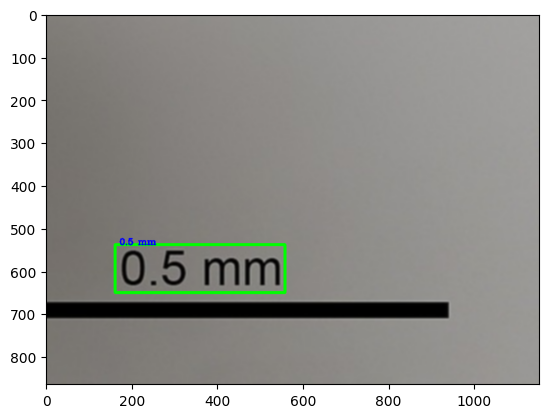

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
127


Using CPU. Note: This module is much faster with a GPU.


[808 971   3]
[161 194   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


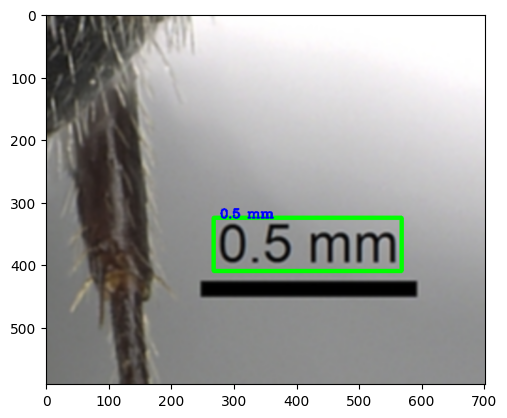

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
128


Using CPU. Note: This module is much faster with a GPU.


[ 808 1002    3]
[161 200   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


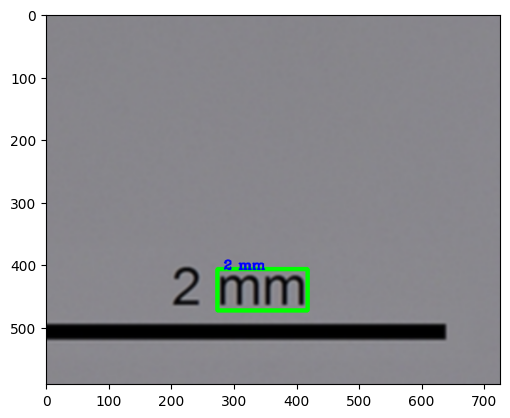

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
129
[808 733   3]
[161 146   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


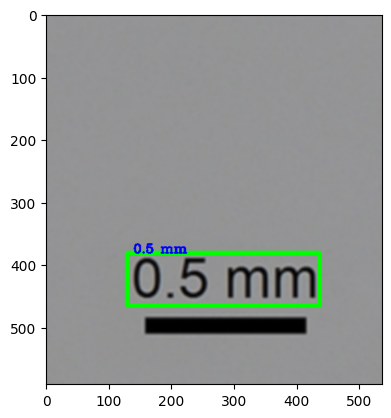

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
130


Using CPU. Note: This module is much faster with a GPU.


[ 808 1249    3]
[161 249   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


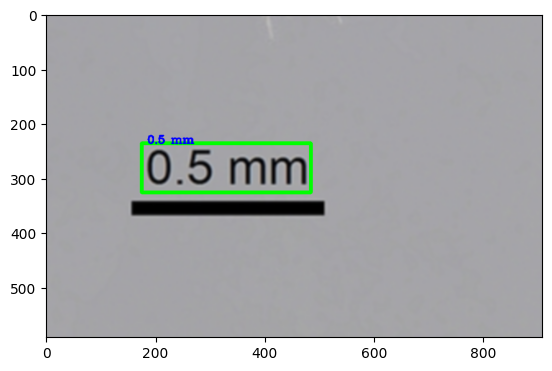

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
131


Using CPU. Note: This module is much faster with a GPU.


[ 808 1081    3]
[161 216   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


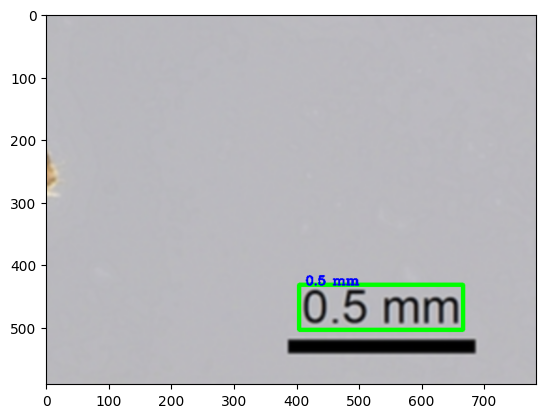

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
132
[ 808 1402    3]
[161 280   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


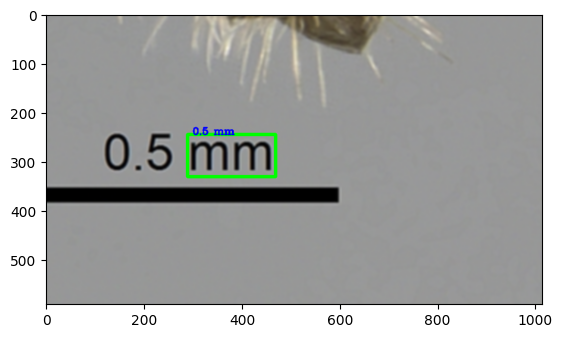

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
133


Using CPU. Note: This module is much faster with a GPU.


[ 808 1030    3]
[161 206   0]


Using CPU. Note: This module is much faster with a GPU.


 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


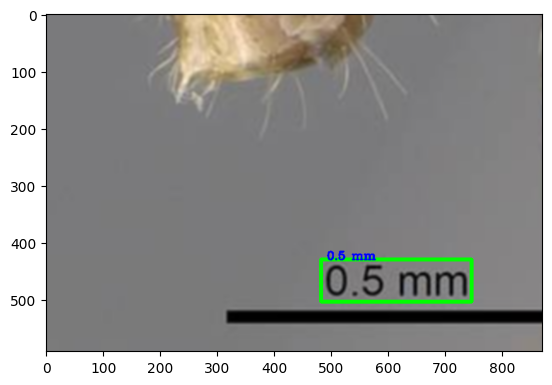

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
134


Using CPU. Note: This module is much faster with a GPU.


[ 808 1048    3]
[161 209   0]


Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


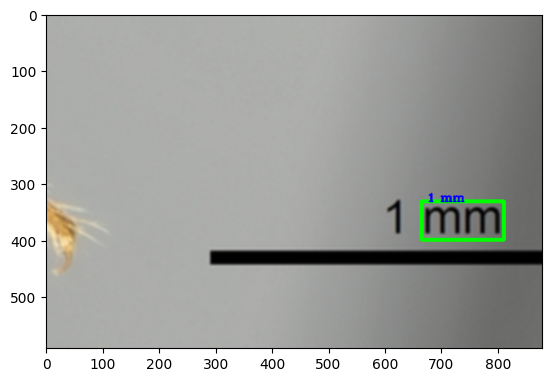

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
135


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


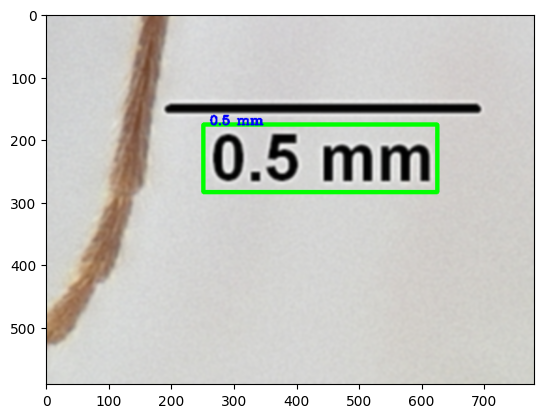

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
136


Using CPU. Note: This module is much faster with a GPU.


[ 808 1072    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


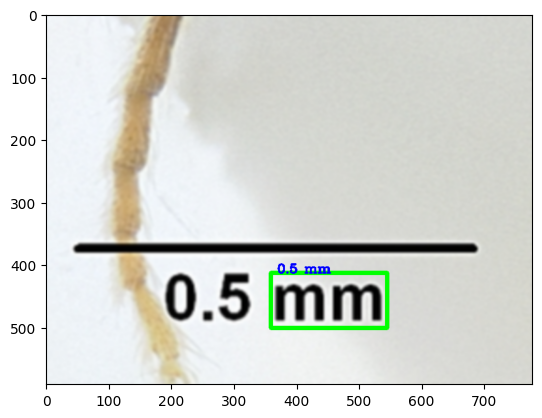

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
137


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


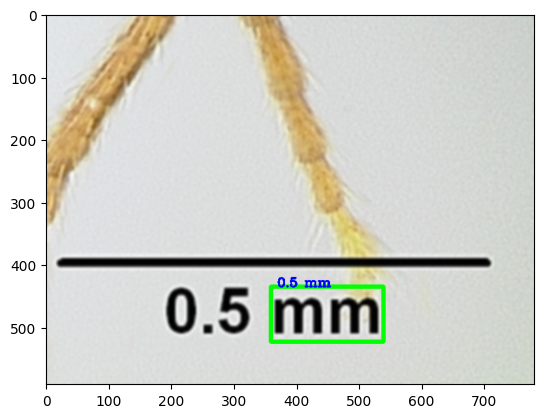

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
138


Using CPU. Note: This module is much faster with a GPU.


[ 808 1084    3]
[161 216   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


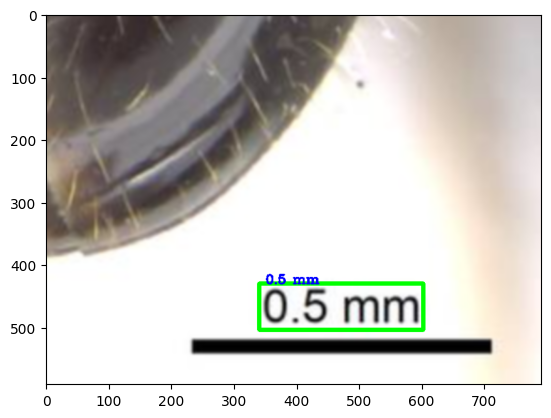

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
139


Using CPU. Note: This module is much faster with a GPU.


[ 808 1087    3]
[161 217   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


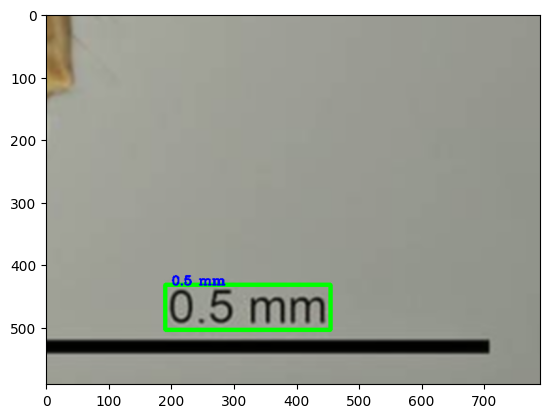

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
140


Using CPU. Note: This module is much faster with a GPU.


[ 808 1066    3]
[161 213   0]


Using CPU. Note: This module is much faster with a GPU.


 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


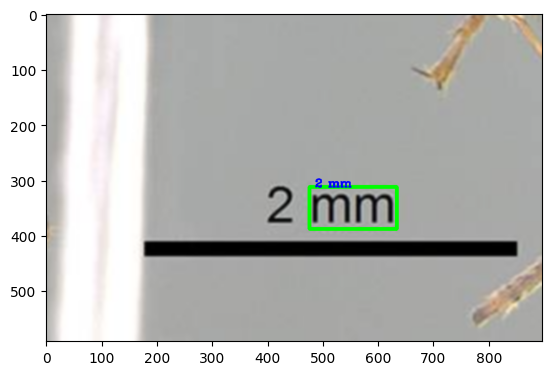

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
141


Using CPU. Note: This module is much faster with a GPU.


[808 938   3]
[161 187   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


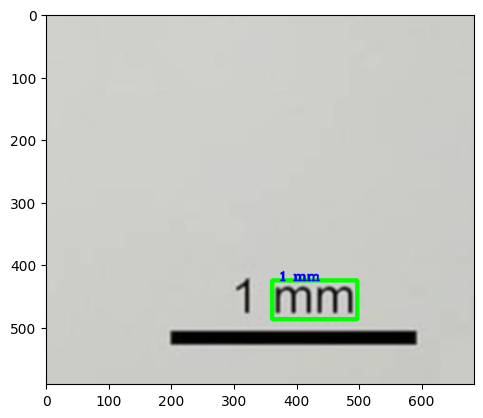

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
142


Using CPU. Note: This module is much faster with a GPU.


[ 808 1156    3]
[161 231   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


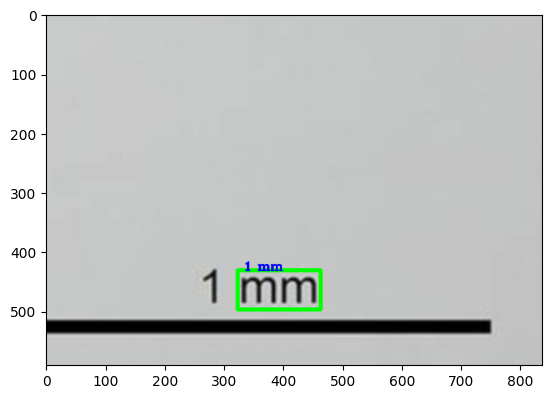

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
143
[1082 1600    3]
[216 320   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


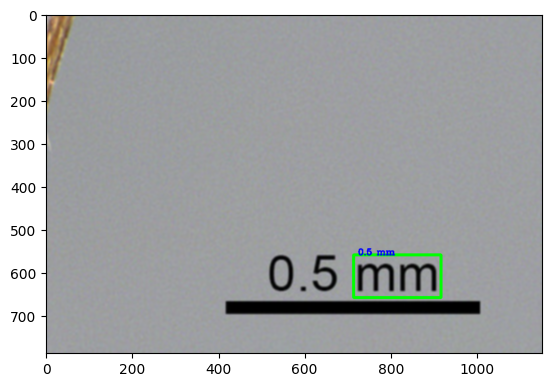

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
144


Using CPU. Note: This module is much faster with a GPU.


[1636 1600    3]
[327 320   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


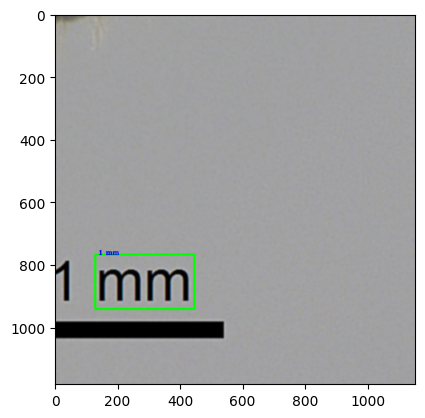

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
145
[ 808 1079    3]
[161 215   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


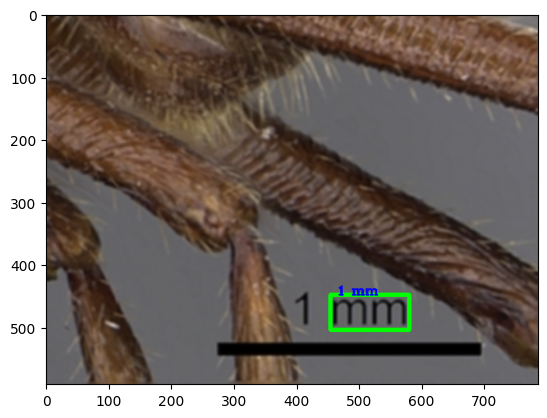

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
146


Using CPU. Note: This module is much faster with a GPU.


[ 808 1215    3]
[161 243   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


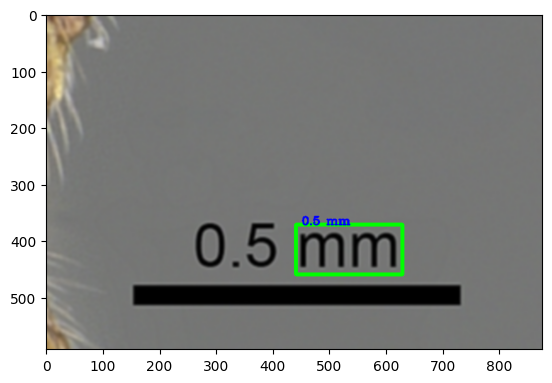

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
147


Using CPU. Note: This module is much faster with a GPU.


[ 808 1751    3]
[161 350   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


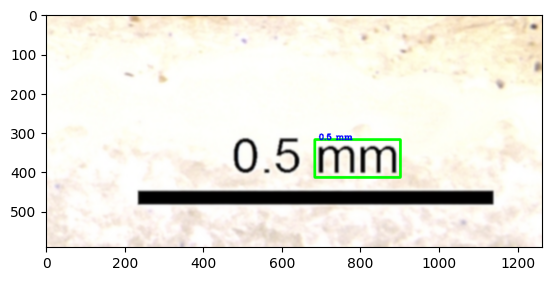

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
148
[ 808 1725    3]
[161 345   0]
 3 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


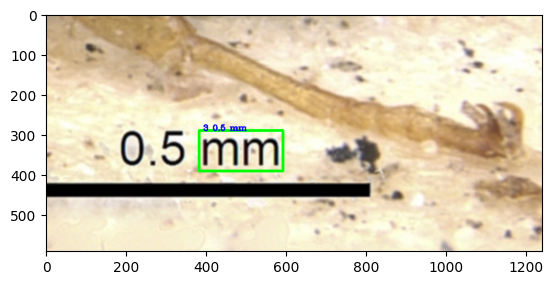

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
149


Using CPU. Note: This module is much faster with a GPU.


[ 808 1782    3]
[161 356   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


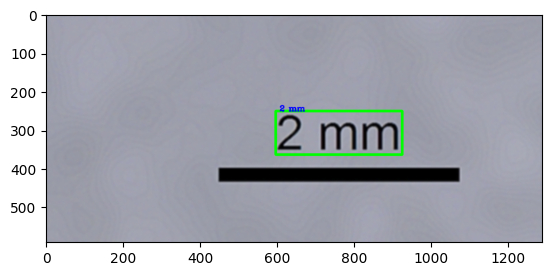

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
150


Using CPU. Note: This module is much faster with a GPU.


[ 808 1131    3]
[161 226   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


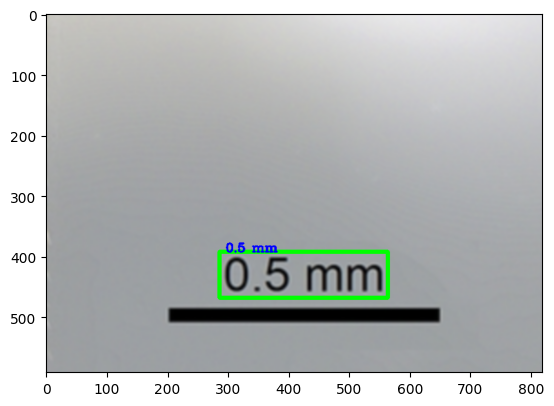

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
151


Using CPU. Note: This module is much faster with a GPU.


[ 808 1375    3]
[161 275   0]


Using CPU. Note: This module is much faster with a GPU.


 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


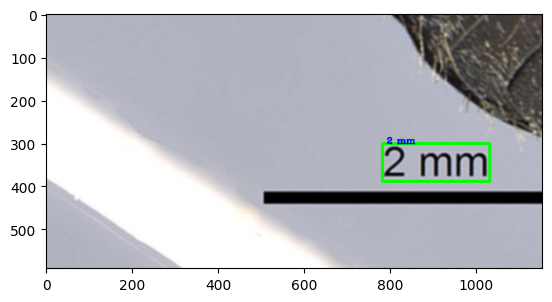

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
152


Using CPU. Note: This module is much faster with a GPU.


[ 808 1201    3]
[161 240   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


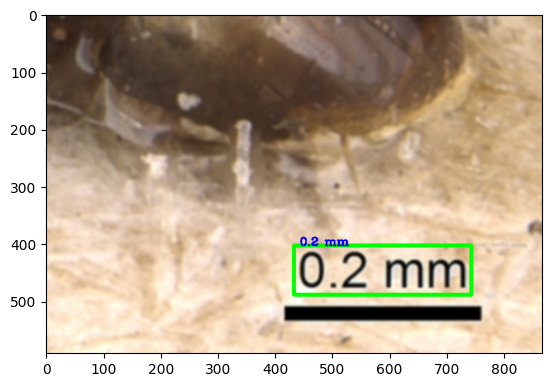

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
153


Using CPU. Note: This module is much faster with a GPU.


[ 808 1393    3]
[161 278   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


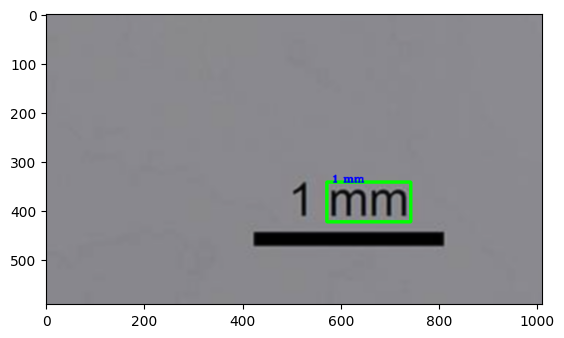

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
154


Using CPU. Note: This module is much faster with a GPU.


[ 808 1029    3]
[161 205   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


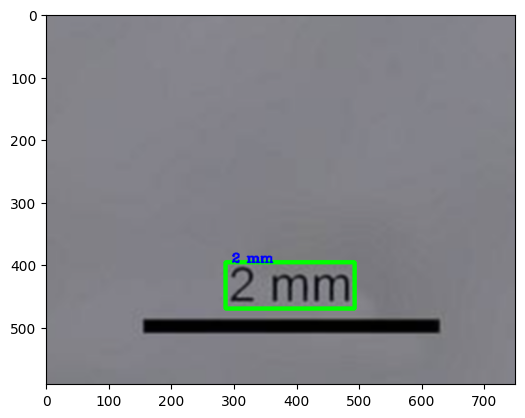

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
155
[ 808 1208    3]
[161 241   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


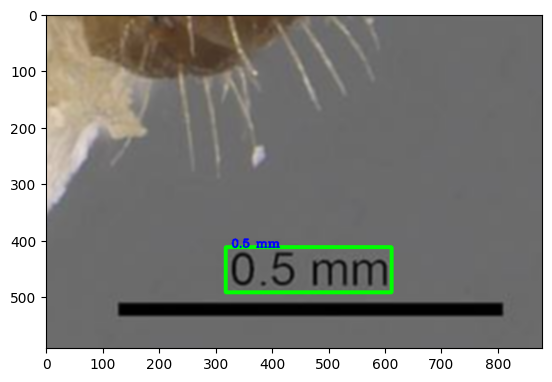

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
156


Using CPU. Note: This module is much faster with a GPU.


[ 808 1072    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


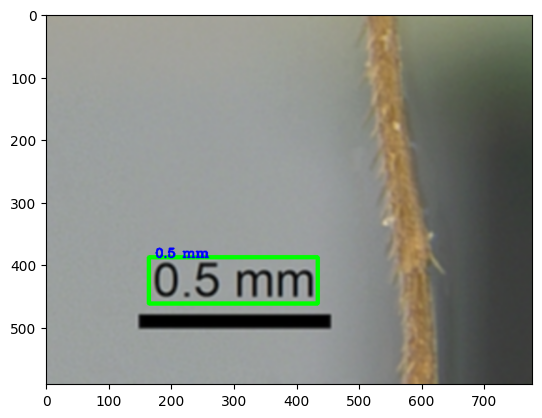

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
157
[ 808 1183    3]
[161 236   0]
 2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


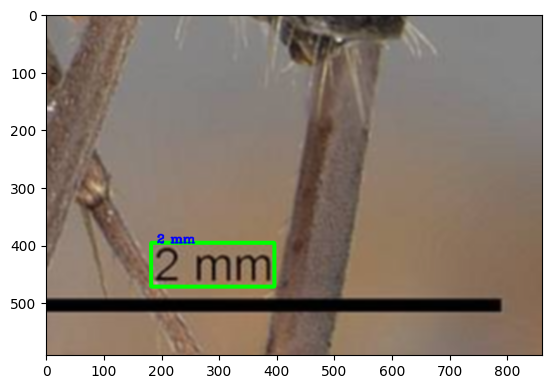

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
158


Using CPU. Note: This module is much faster with a GPU.


[ 808 1454    3]
[161 290   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


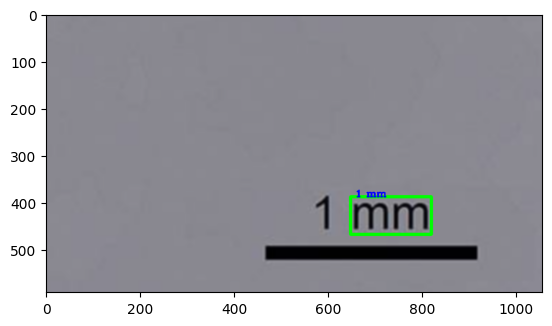

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
159


Using CPU. Note: This module is much faster with a GPU.


[ 808 1533    3]
[161 306   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


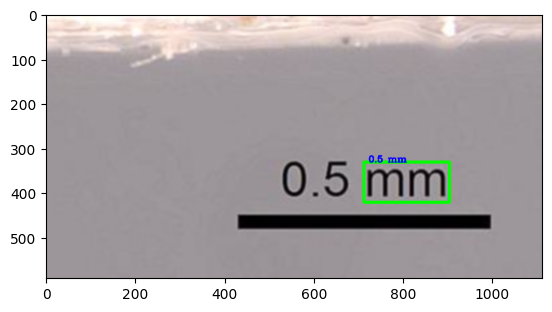

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
160


Using CPU. Note: This module is much faster with a GPU.


[ 808 1534    3]
[161 306   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


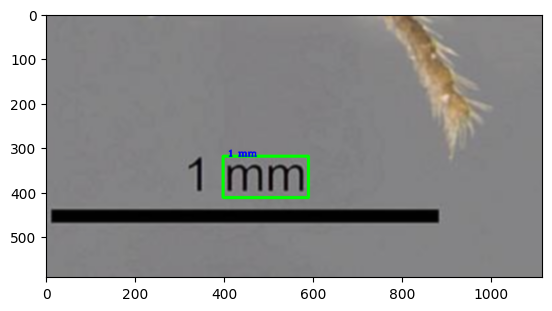

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
161
[ 808 1660    3]
[161 332   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


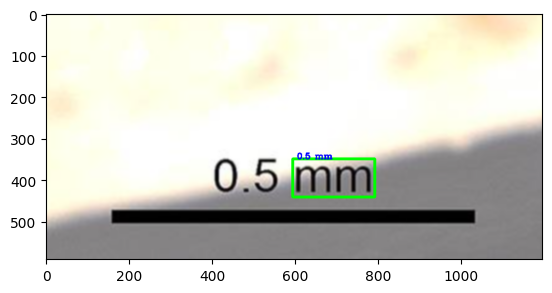

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
162
[ 808 1156    3]
[161 231   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


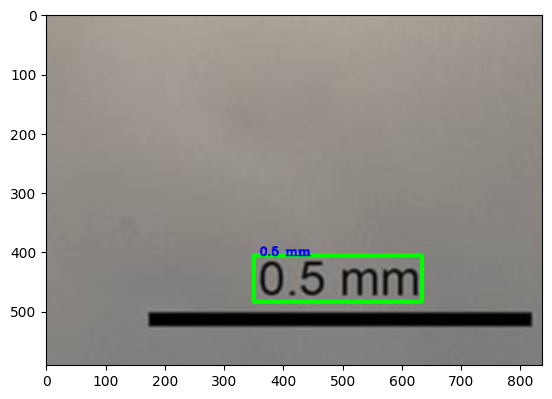

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
163
[ 808 1285    3]
[161 257   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


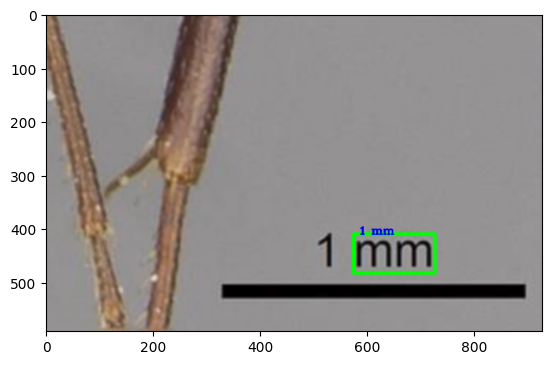

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
164


Using CPU. Note: This module is much faster with a GPU.


[ 808 1137    3]
[161 227   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


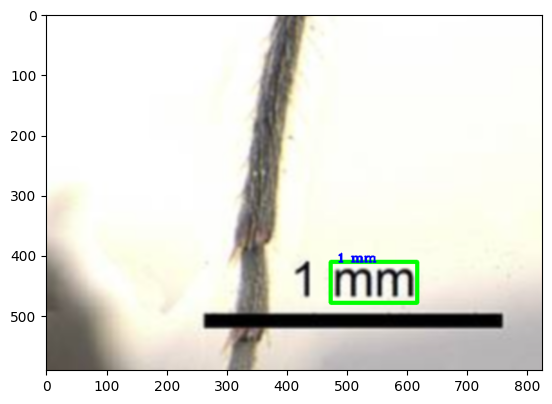

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
165


Using CPU. Note: This module is much faster with a GPU.


[ 808 1728    3]
[161 345   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


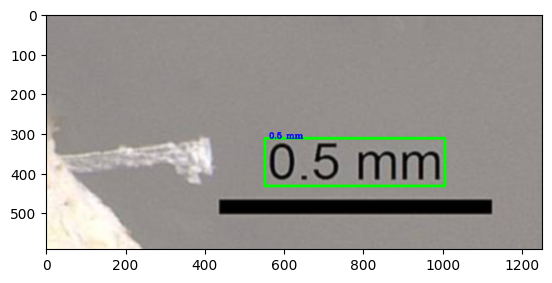

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
166


Using CPU. Note: This module is much faster with a GPU.


[ 808 1564    3]
[161 312   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


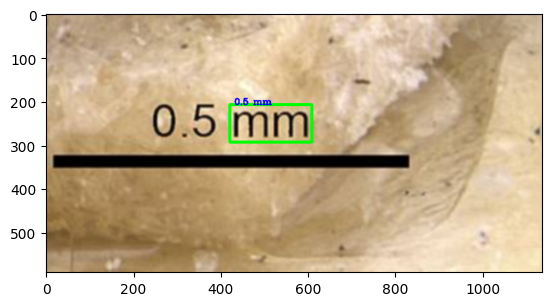

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
167


Using CPU. Note: This module is much faster with a GPU.


[ 808 1282    3]
[161 256   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


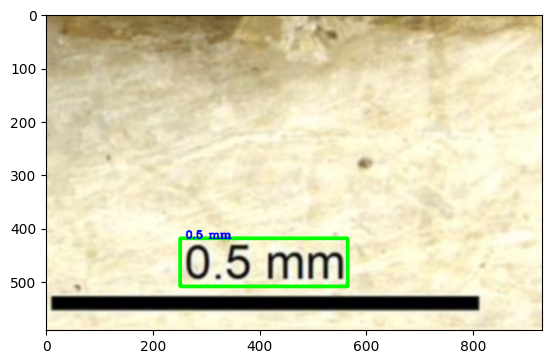

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
168
[ 808 1131    3]
[161 226   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


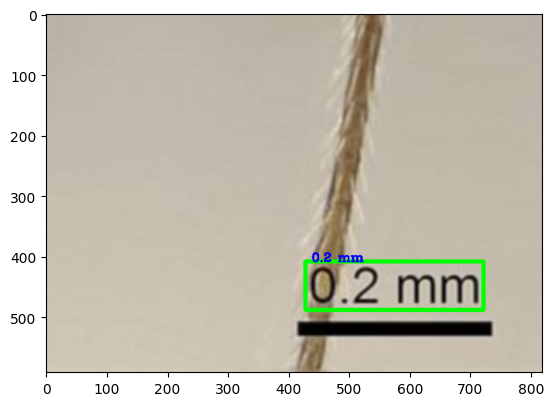

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
169


Using CPU. Note: This module is much faster with a GPU.


[ 808 1402    3]
[161 280   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


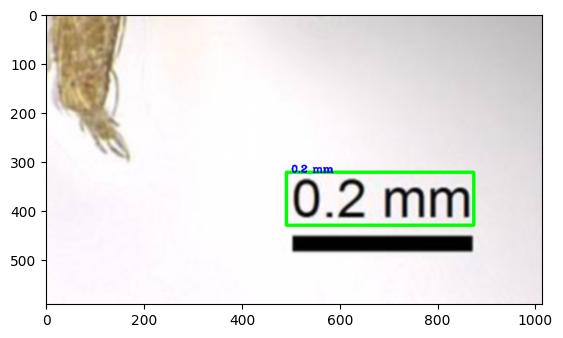

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
170
[ 808 1226    3]
[161 245   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


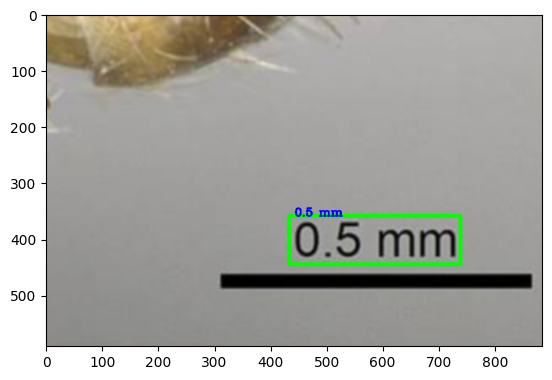

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
171


Using CPU. Note: This module is much faster with a GPU.


[ 808 1403    3]
[161 280   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


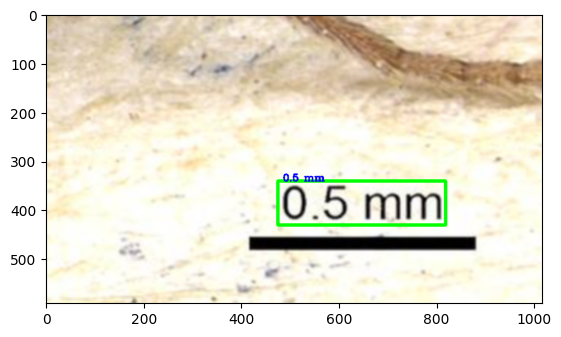

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
172


Using CPU. Note: This module is much faster with a GPU.


[ 808 1070    3]
[161 214   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


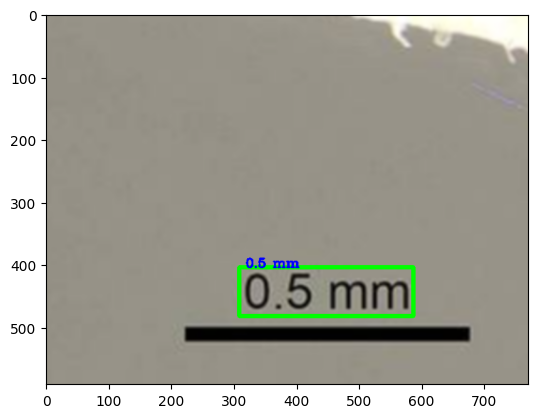

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
173


Using CPU. Note: This module is much faster with a GPU.


[ 808 1077    3]
[161 215   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


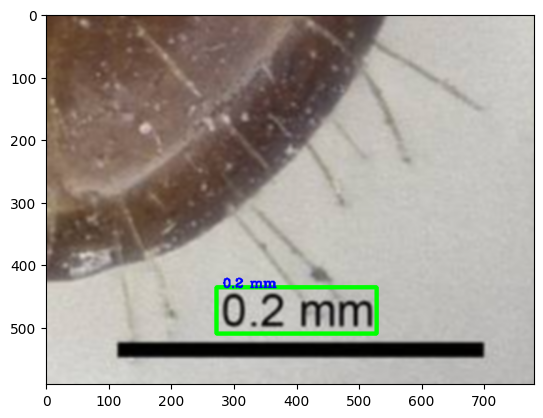

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
174


Using CPU. Note: This module is much faster with a GPU.


[ 808 1073    3]
[161 214   0]


Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


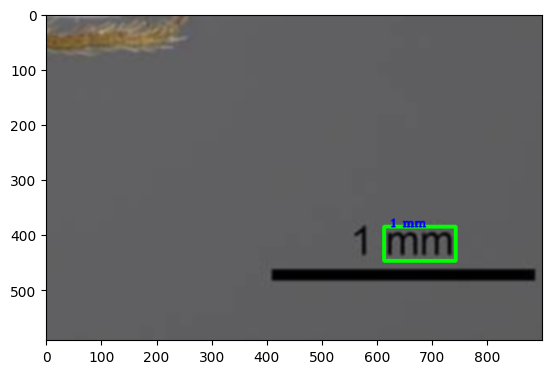

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
175


Using CPU. Note: This module is much faster with a GPU.


[ 833 1600    3]
[166 320   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


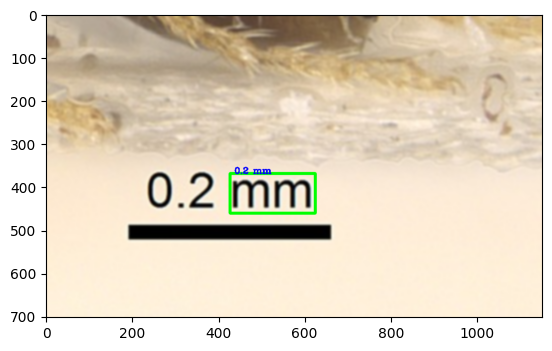

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
176


Using CPU. Note: This module is much faster with a GPU.


[ 808 1113    3]
[161 222   0]
 0.2 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


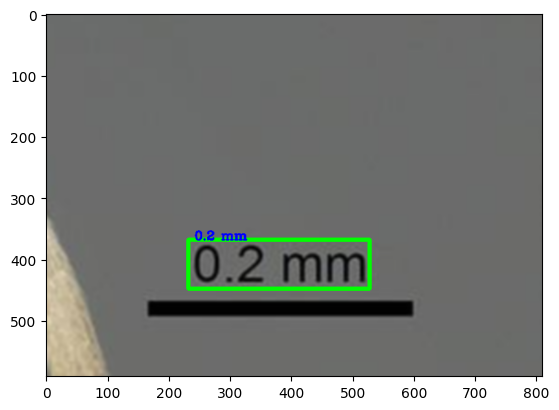

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
177
[ 953 1600    3]
[190 320   0]
 0.2mm
<built-in method isnumeric of str object at 0x103e1b8f8>


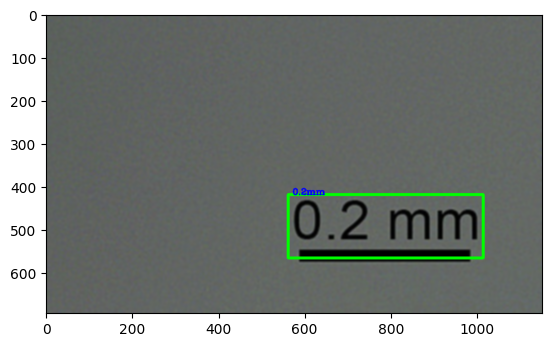

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
178


Using CPU. Note: This module is much faster with a GPU.


[ 808 1087    3]
[161 217   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with

 1mm
<built-in method isnumeric of str object at 0x103e1b8f8>


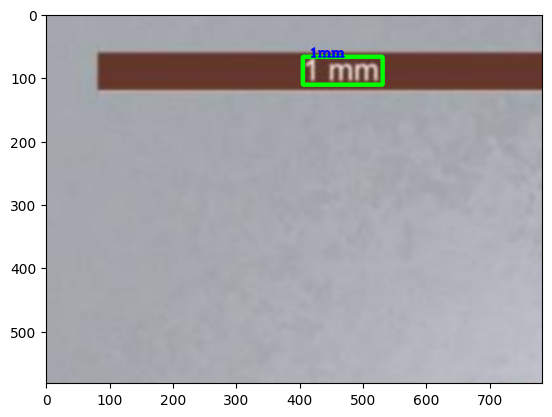

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
179


Using CPU. Note: This module is much faster with a GPU.


[ 808 1086    3]
[161 217   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with

 0,5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


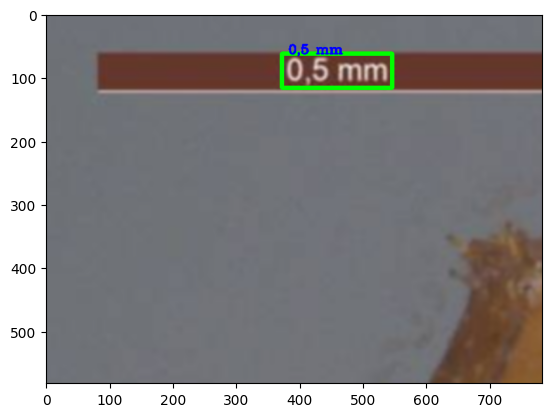

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
180


Using CPU. Note: This module is much faster with a GPU.


[ 808 1181    3]
[161 236   0]


Using CPU. Note: This module is much faster with a GPU.


 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


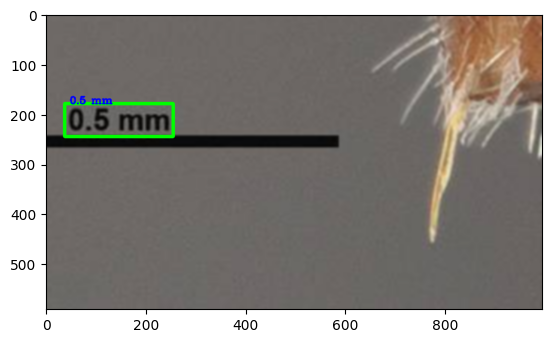

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
181


Using CPU. Note: This module is much faster with a GPU.


[ 808 1178    3]
[161 235   0]


Using CPU. Note: This module is much faster with a GPU.


 30 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


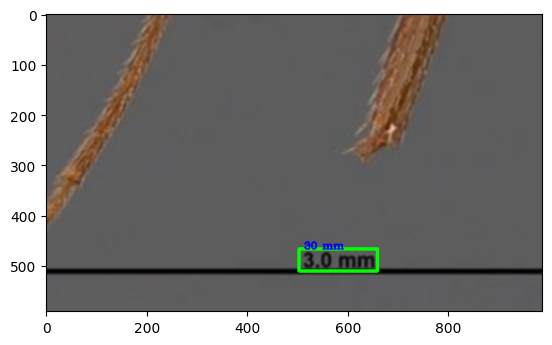

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
182


Using CPU. Note: This module is much faster with a GPU.


[ 808 1081    3]
[161 216   0]
 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


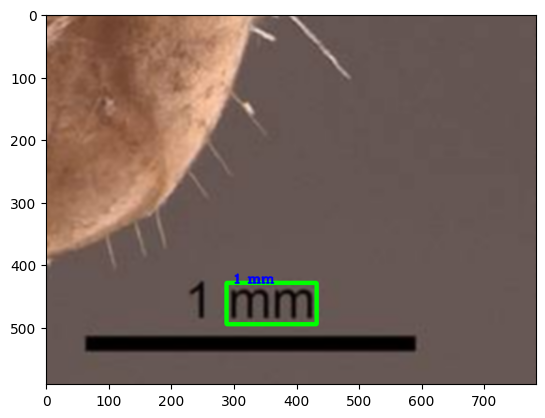

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
183
[ 808 1168    3]
[161 233   0]


Using CPU. Note: This module is much faster with a GPU.


 2.0 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


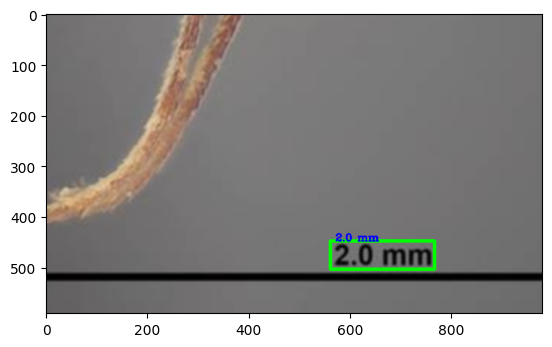

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
184


Using CPU. Note: This module is much faster with a GPU.


[ 808 1677    3]
[161 335   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 Imm
<built-in method isnumeric of str object at 0x103e1b8f8>


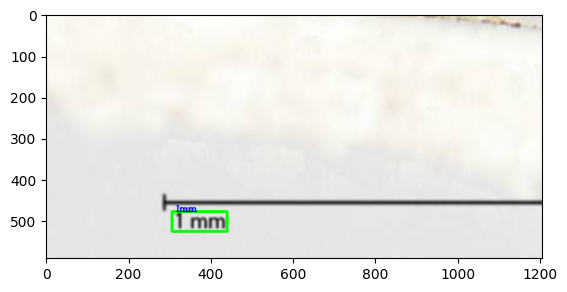

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
185


Using CPU. Note: This module is much faster with a GPU.


[ 808 1042    3]
[161 208   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


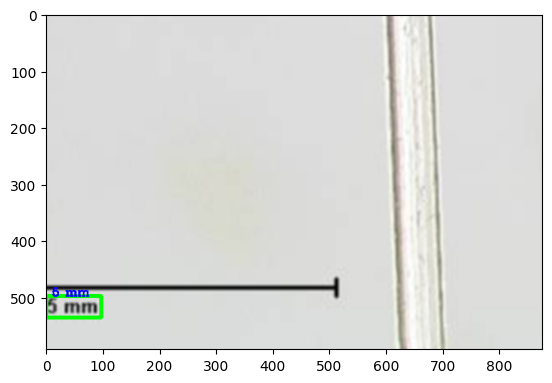

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
186


Using CPU. Note: This module is much faster with a GPU.


[ 808 1119    3]
[161 223   0]
 1 mIn
<built-in method isnumeric of str object at 0x103e1b8f8>


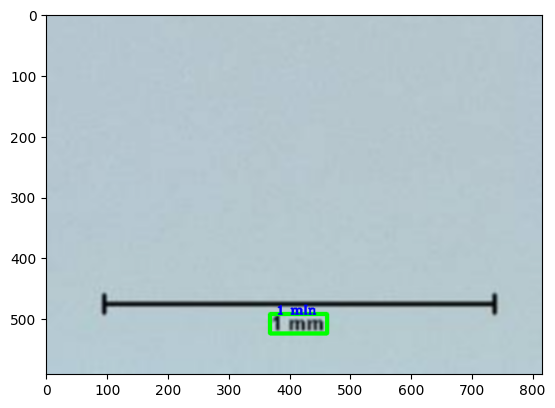

Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
187


Using CPU. Note: This module is much faster with a GPU.


[ 808 1980    3]
[161 396   0]


Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.
Using CPU. Note: This module is much faster with a GPU.


 1mm
<built-in method isnumeric of str object at 0x103e1b8f8>


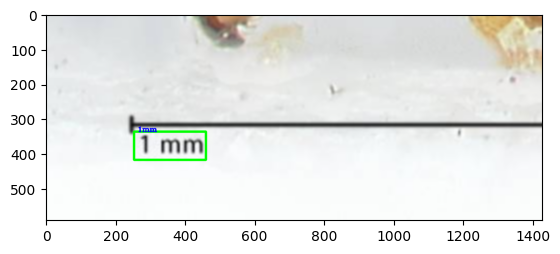

Using CPU. Note: This module is much faster with a GPU.


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
188
[ 808 1426    3]
[161 285   0]


Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


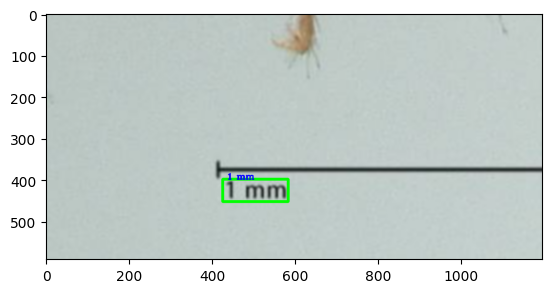

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
189


Using CPU. Note: This module is much faster with a GPU.


[ 808 1296    3]
[161 259   0]


Using CPU. Note: This module is much faster with a GPU.


 1 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


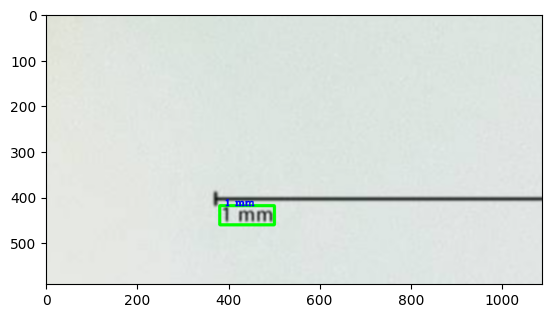

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
190


Using CPU. Note: This module is much faster with a GPU.


[ 808 1287    3]
[161 257   0]
 0.5 mm
<built-in method isnumeric of str object at 0x103e1b8f8>


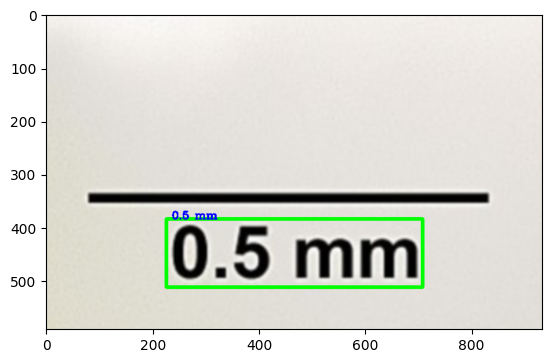

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 
191


AttributeError: 'NoneType' object has no attribute 'shape'

In [ ]:
import os

path_images = "/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/NAE - Files/Downloads/original/"
path_name_validation_set = "/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/names_images.txt"
path_directory_save = "/Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/text_detection_results/"
name_results_text_file = "/results.txt"

"""
with open(path_directory_save + name_results_text_file, 'x') as file:
    # Write content to the file
    file.write("")
"""   
           
count = 0
with open(path_name_validation_set, "r") as file:
        for line in file:
            count = count + 1
            print("- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - ")
            print(count)
            name_file = line.strip()
            summary, text = detect_text(path_images, name_file, path_directory_save, 5, 0.2, 3)
            with open(path_directory_save + name_results_text_file, 'a') as file:
                file.write(text + "\n")
